## Imports and loads

In [1]:
import os, sys
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.model_selection import ShuffleSplit, cross_val_score
from sklearn.model_selection import train_test_split,GridSearchCV,cross_val_score, cross_val_predict
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, f1_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import tensorflow as tf
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, f1_score
from sklearn.metrics import r2_score
from sklearn import linear_model
from scipy.stats import linregress
from scipy.stats import spearmanr
from sklearn.base import  BaseEstimator, TransformerMixin, ClassifierMixin
from sklearn.model_selection import StratifiedShuffleSplit
from scipy.signal import butter, filtfilt, lfilter, welch, lfilter_zi, stft
import pandas as pd
from scipy.stats import spearmanr
from sklearn.model_selection import LeaveOneOut
import pickle
from time import time
from  scipy.spatial.distance import squareform
import matplotlib.colors as colors
import matplotlib.cm as cmx
import pickle

In [2]:
!pip install mne==0.19
import mne
!pip install git+https://github.com/UN-GCPDS/python-gcpds.utils.git
from gcpds.utils import loaddb

     |████████████████████████████████| 6.4MB 11.9MB/s 
  Cloning https://github.com/UN-GCPDS/python-gcpds.utils.git to /tmp/pip-req-build-suy1biex
  Running command git clone -q https://github.com/UN-GCPDS/python-gcpds.utils.git /tmp/pip-req-build-suy1biex
  Created wheel for gcpds-utils: filename=gcpds_utils-0.1a3-cp36-none-any.whl size=96940 sha256=1ce569b9975f0cebb3f9c6ee8268646035ba54116fc3edf50bb8c25bb9c306f9
  Stored in directory: /tmp/pip-ephem-wheel-cache-voabrovk/wheels/ab/4a/1e/d215a31a12c0fa202a9bccc9b9d68874deb08dfdce8b7d43c8
Successfully built gcpds-utils


In [3]:
from mne.io.pick import _picks_to_idx
from mne.viz.topomap import _check_outlines, _draw_outlines
from mne.viz import plot_topomap

In [4]:
FILEID = "1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5"
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id='$FILEID -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id="$FILEID -O Data_rest_giga.zip && rm -rf /tmp/cookies.txt
!dir
!unzip Data_rest_giga.zip

--2021-01-22 17:00:37--  https://docs.google.com/uc?export=download&confirm=&id=1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5
Resolving docs.google.com (docs.google.com)... 108.177.127.101, 108.177.127.138, 108.177.127.139, ...
Connecting to docs.google.com (docs.google.com)|108.177.127.101|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-00-1g-docs.googleusercontent.com/docs/securesc/oueiaeh0j7j2bht8v7i5iq9rk8mqtrs5/8o4nj22t3qte6r3sn1mj3tpuon9i9e11/1611334800000/13064322042220169363/07510879241486770601Z/1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5?e=download [following]
--2021-01-22 17:00:37--  https://doc-00-1g-docs.googleusercontent.com/docs/securesc/oueiaeh0j7j2bht8v7i5iq9rk8mqtrs5/8o4nj22t3qte6r3sn1mj3tpuon9i9e11/1611334800000/13064322042220169363/07510879241486770601Z/1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5?e=download
Resolving doc-00-1g-docs.googleusercontent.com (doc-00-1g-docs.googleusercontent.com)... 74.125.128.132, 2a00:1450:4013:c02::84
Connecting

## Network definition

In [5]:
seed = 100
np.random.seed(seed)
tf.random.set_seed(seed)
        
class SMRfeat(BaseEstimator, TransformerMixin):
  def __init__(self):
    self
      
  
  def scalerlist(self,Xfull):
     self.scaler = len(Xfull)*[None]
     for i in range(len(Xfull)):
        self.scaler[i] = StandardScaler()
        Xfull[i] = self.scaler[i].fit_transform(Xfull[i])
     return Xfull


  def fit(self,Xepochs,*_):
      
      Xfull = [Xepochs[:,:,i] for i in range(Xepochs.shape[2])]


      
      self.scalerlist(Xfull)
      return 

  def transform(self,Xepochs,*_):   
      
          
      
      Xfull = [Xepochs[:,:,i] for i in range(Xepochs.shape[2])]

      
      for i in range(len(Xfull)):
         self.scaler[i] = StandardScaler()
         Xfull[i] = self.scaler[i].fit_transform(Xfull[i])
      return Xfull

  def fit_transform(self,Xepochs,*_):
      self.fit(Xepochs)
      return self.transform(Xepochs)   
class MCSMRDNN(BaseEstimator, TransformerMixin):
  def __init__(self,epochs=200,batch_size=32,learning_rate=1e-3,optimizer='Adam',
                l1_param=1e-3,l2_param=1e-3,validation_split=0.2,verbose=0,fs=512,scalex=1,scaley=1,droprate=0.2,Mc_iter=100,alpha_dropout=True,plot_hst = False):
        self.epochs = epochs
        self.scalex = scalex
        self.scaley = scaley
        self.batch_size = batch_size
        self.learning_rate=learning_rate 
        self.l1_param=l1_param 
        self.l2_param=l2_param
        self.validation_split = validation_split
        self.verbose = verbose
        self.optimizer = optimizer
        self.fs=fs
        self.droprate = droprate
        self.Mc_iter = Mc_iter
        self.alpha_dropout = alpha_dropout
        self.plot_hst = plot_hst
  
  def fit(self,X,y,*_):

    #entrenar predictor SMRDNN
    if self.optimizer == "Adam":
        opt = tf.keras.optimizers.Adam(learning_rate=self.learning_rate)
    elif self.optimizer == "SGD":
        opt = tf.keras.optimizers.SGD(learning_rate=self.learning_rate)
    else:
        opt=self.optimizer
    
    tf.keras.backend.clear_session()
    seed = 100
    np.random.seed(seed)
    tf.random.set_seed(seed)
    Q1f = 1.5
    Qff = 0.5
    l1 = self.l1_param
    l2 = self.l2_param
    act1 = 'tanh'
    actf = 'tanh'
    inputs = len(X)*[None]
    hiddens = len(X)*[None]
    drop_1 = len(X)*[None]
    winitializer = tf.keras.initializers.GlorotNormal(seed=seed)
    binitializer = "zeros"
    #h1
    for i in range(len(X)):
        inputs[i] = tf.keras.layers.Input(shape=(X[i].shape[1]), name='in_'+str(i))
        hiddens[i] = tf.keras.layers.Dense(int(X[i].shape[1]*Q1f),activation=act1,kernel_regularizer=tf.keras.regularizers.l1_l2(l1=l1,l2=l2),kernel_initializer=winitializer,bias_initializer=binitializer,name='h1_'+str(i))(inputs[i])
        if self.alpha_dropout:
            drop_1[i] = tf.keras.layers.AlphaDropout(self.droprate,seed=seed)(hiddens[i])
        else:
            drop_1[i] = tf.keras.layers.Dropout(self.droprate)(hiddens[i])
    #concat
    concat = tf.keras.layers.concatenate(drop_1,name='concat')
    #concat = tf.keras.layers.concatenate([h1c3psd,h1c4psd],name='concat')
    Qh = np.sum([X[i].shape[1]*Q1f for i in range(len(X))])
    
    hfi = tf.keras.layers.Dense(Qh*Qff,activation=actf,kernel_regularizer=tf.keras.regularizers.l1_l2(l1=l1,l2=l2),
                              kernel_initializer=winitializer,
                              bias_initializer=binitializer,name='hfi')(concat)
    if self.alpha_dropout:
        drop_2 = tf.keras.layers.AlphaDropout(rate=self.droprate)(hfi)
    else:
        drop_2 = tf.keras.layers.Dropout(rate=self.droprate)(hfi)
    #cla
    output_c = tf.keras.layers.Dense(1,activation="linear",kernel_initializer=winitializer, bias_initializer=binitializer,
                                    kernel_regularizer=tf.keras.regularizers.l1_l2(l1=l1,l2=l2),name='outc')(drop_2) 
    #input_full = [ic3_tuz,ic4_tuz,ic3_tbz,ic4_tbz,ic3_psdz,ic4_psdz]
    self.model_fun = tf.keras.Model(inputs=inputs,outputs=[output_c])

    self.model_fun.compile(loss=tf.keras.losses.mae,#self.custom_loss(),
              optimizer=opt) #f1, precision, recall, crossentropy

    self.history = self.model_fun.fit(x=X, y=y,verbose=self.verbose,
                        epochs=self.epochs,batch_size=self.batch_size,validation_split=self.validation_split)
    if self.plot_hst:
        self.plot_history_acc_w()
  def predict(self, X, *_):
    return np.stack([self.model_fun(X,training=True) for sample in range(self.Mc_iter)])#self.model_fun.predict(X)

  def fit_predict(self,X,y,*_):
      self.fit(X,y)
      return  self.predict(X)
  def get_model(self):
      return self.model_fun
  def plot_history_acc_w(self):
      hpd = pd.DataFrame(self.history.history)
      #hpd[['loss','val_loss']].plot()
      hpd.plot()
      plt.show()
      return


## Funtions definitions

In [6]:
def get_weigths(model,bands):
    W = []
    for i in range(bands):
        w = np.sum(abs(mdl.get_layer('h1_'+str(i)).get_weights()[0]),axis=1)
        w = w-min(w)
        w/= max(w)
        W.append(w)
    return W

In [7]:
def create_tensor_giga(graf,ind):
    xtensor = []
    for i in ind:
      if i>= 29 and i<34:
        subjs= graf[i-2,:,:]
      elif i>=34:
        subjs= graf[i-3,:,:]
      else:
        subjs= graf[i-1,:,:]

      try:
        xtensor+=[subjs]
      except:
        print('s'+str(i+1))

    xtensor= np.asarray(xtensor)
    print(xtensor.shape)
    return xtensor

In [8]:
def plot_topomap_cx(rho,fs, channels_names,montage,Ch,thr=0.5,size=(10,10),mode="topo",weigths=True,cmaps="jet",colormap=True,save=False,name=""):
    layout = mne.channels.read_layout('EEG1005')
    info = mne.create_info(layout.names, sfreq=fs, ch_types="eeg",montage=montage)
    pos = np.array([(p[0] + p[2] / 2., p[1] + p[3] / 2.) for p in layout.pos])

    # pick channels
    picks = _picks_to_idx(info,channels_names)
    pos = pos[picks]
    # adjust positions
    pos, outlines = _check_outlines(pos, 'head')
    pos_x = pos[:,0]
    pos_y = pos[:,1]
    names = np.array(layout.names)[picks]
    rho=((rho-rho.min())/(rho.max()-rho.min()))
    cmap = plt.cm.jet
    cNorm  = colors.Normalize(vmin=np.min(rho), vmax=np.max(rho))
    scalarMap = cmx.ScalarMappable(norm=cNorm,cmap=cmap)

    if weigths:
        rhotopo = squareform(rho).sum(axis=1)
    else:
        rhotopo = rho
    rhotopo = rhotopo-rhotopo.min()
    rhotopo /= rhotopo.max()
    
    f = plt.figure(figsize=size)
    ax = plt.axes()

    if mode=="topo":
        #P = int(0.5*Ch*(Ch-1))

        #plt.figure(figsize=(10,10))
        plot_topomap(rhotopo, pos, cmap=cmaps, show=False, contours=0, sensors=False,vmin=0,vmax=1)

    elif mode=="Cx":
        rhok = squareform(rho)

        if thr >1:
            indx_pct = np.where(np.triu(rhok)>np.percentile(rho, thr))
        else:
            indx_pct = np.where(np.triu(rhok)>thr)
        ax.set(xticks=[], yticks=[], aspect='equal')
        #ax[frec,time].scatter(pos[:,0],pos[:,1],100)
        _draw_outlines(ax, outlines)
        for i in range(np.shape(indx_pct)[-1]):
            ch1=indx_pct[0][i]
            ch2=indx_pct[1][i]     
            ax.arrow(pos_x[ch1],pos_y[ch1],pos_x[ch2]-pos_x[ch1],
                    pos_y[ch2]-pos_y[ch1],head_width=0.0,length_includes_head=False,
                    width=0.003,color=scalarMap.to_rgba(rhok[ch1,ch2]))
        for ch1 in  np.unique(np.ravel(indx_pct)):
            ax.scatter(pos_x[ch1],pos_y[ch1],50*np.sum(np.ravel(indx_pct)==ch1),'gray')
            ax.annotate(names[ch1], xy=pos[ch1,:],size=15)
        ax.axis("off")
    elif mode=="All":
        plot_topomap(rhotopo, pos, cmap=cmaps, show=False, contours=0, sensors=False,vmin=0,vmax=1)
        rhok = squareform(rho)

        if thr >1:
            indx_pct = np.where(np.triu(rhok)>np.percentile(rho, thr))
        else:
            indx_pct = np.where(np.triu(rhok)>thr)
        ax.set(xticks=[], yticks=[], aspect='equal')
        #ax[frec,time].scatter(pos[:,0],pos[:,1],100)
        _draw_outlines(ax, outlines)
        for i in range(np.shape(indx_pct)[-1]):
            ch1=indx_pct[0][i]
            ch2=indx_pct[1][i]     
            ax.arrow(pos_x[ch1],pos_y[ch1],pos_x[ch2]-pos_x[ch1],
                    pos_y[ch2]-pos_y[ch1],head_width=0.0,length_includes_head=False,
                    width=0.003,color=scalarMap.to_rgba(rhok[ch1,ch2]))
        for ch1 in  np.unique(np.ravel(indx_pct)):
            ax.scatter(pos_x[ch1],pos_y[ch1],50*np.sum(np.ravel(indx_pct)==ch1),'gray')
            ax.annotate(names[ch1], xy=pos[ch1,:],size=15)
        

    if colormap:
        cax = f.add_axes([0.95, 0.125, 0.02, 0.75])
        sm = plt.cm.ScalarMappable(cmap='jet')
        sm.set_array(rho.ravel())
        plt.colorbar(sm,cax=cax)
    
    if save:
        plt.savefig(name+'.eps',format='eps',dpi=100,bbox_inches='tight')

    plt.show()

In [9]:
def get_run(plv_conect,run):
   X=[]
   for sbj in plv_conect:
       if int(sbj.shape[0]/20) >= run:
           X.append(np.mean(sbj[20*(run-1):20*run,:,:],axis=0,keepdims=True))
       else:
           X.append(np.mean(sbj[-20::,:,:],axis=0,keepdims=True))
   
   return np.concatenate(X, axis=0)          

## Path definition

In [10]:
Path_def = "/content/drive/MyDrive/Papers/CX_Regression/codigos/giga/Figs/"

## load data and run

In [11]:
target = pickle.load( open( "/content/drive/MyDrive/Papers/CX_Regression/codigos/giga/target_por_runs/target_giga_runs2seg_5time_2frec.p", "rb" ) ) 
plv_conect = pickle.load( open( "/content/drive/MyDrive/Papers/CX_Regression/codigos/pruebas_por_runs/conectividades_por_runs/conect_r0_plv.p", "rb" ) ) 
Target_run=[]
for i in range(5):
  run_n = []
  for j in range(len(target['acc_subj'])):
    if target['acc_subj'][j].shape[0]>=i+1:
      run_n.append(target['acc_subj'][j][i])
    else:
      run_n.append(target['acc_subj'][j][-1])
  Target_run.append(np.asarray(run_n))  

/usr/local/lib/python3.6/dist-packages/mne/utils/docs.py:824: DeprecationWarning: Function read_montage is deprecated; ``read_montage`` is deprecated and will be removed in v0.20. Please use ``read_dig_fif``, ``read_dig_egi``, ``read_custom_montage``, or ``read_dig_captrack`` to read a digitization based on your needs instead; or ``make_standard_montage`` to create ``DigMontage`` based on template; or ``make_dig_montage`` to create a ``DigMontage`` out of np.arrays
  warnings.warn(msg, category=DeprecationWarning)
/usr/local/lib/python3.6/dist-packages/mne/utils/docs.py:807: DeprecationWarning: Class Montage is deprecated; Montage class is deprecated and will be removed in v0.20. Please use DigMontage instead.
  warnings.warn(msg, category=DeprecationWarning)


grupos:  [2, None, None]
run:  1
Epoch 1/200
1/1 [==============================] - 3s 3s/step - loss: 724.0150 - val_loss: 745.3207
Epoch 2/200
1/1 [==============================] - 0s 64ms/step - loss: 751.0785 - val_loss: 698.4641
Epoch 3/200
1/1 [==============================] - 0s 60ms/step - loss: 692.6535 - val_loss: 723.8547
Epoch 4/200
1/1 [==============================] - 0s 56ms/step - loss: 703.6559 - val_loss: 710.2638
Epoch 5/200
1/1 [==============================] - 0s 57ms/step - loss: 677.2526 - val_loss: 689.0236
Epoch 6/200
1/1 [==============================] - 0s 59ms/step - loss: 648.9194 - val_loss: 666.0140
Epoch 7/200
1/1 [==============================] - 0s 182ms/step - loss: 624.4755 - val_loss: 641.9182
Epoch 8/200
1/1 [==============================] - 0s 78ms/step - loss: 602.2948 - val_loss: 617.6643
Epoch 9/200
1/1 [==============================] - 0s 57ms/step - loss: 578.9310 - val_loss: 593.5894
Epoch 10/200
1/1 [==============================] 

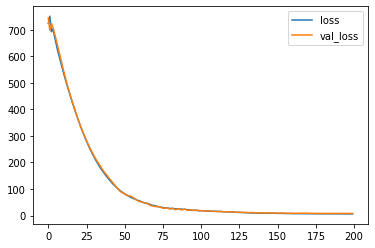

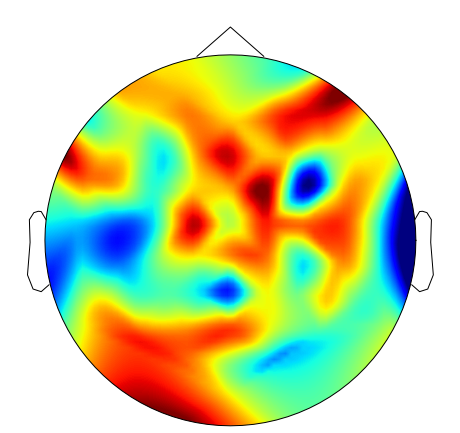

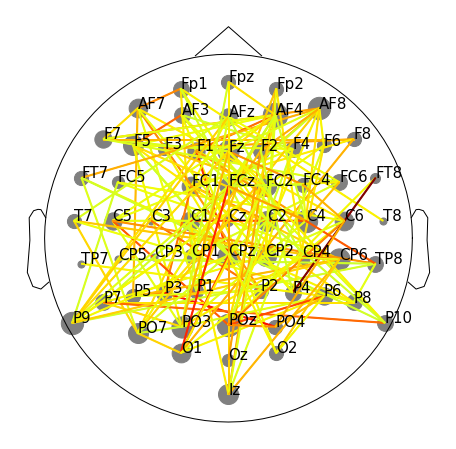

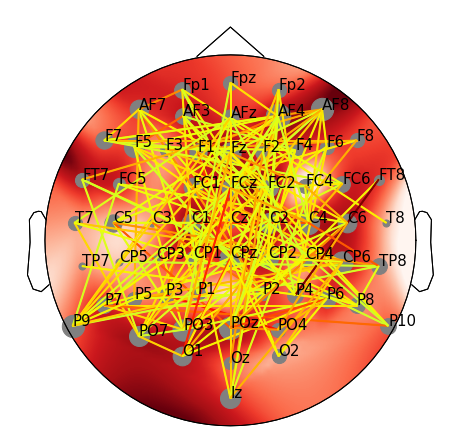

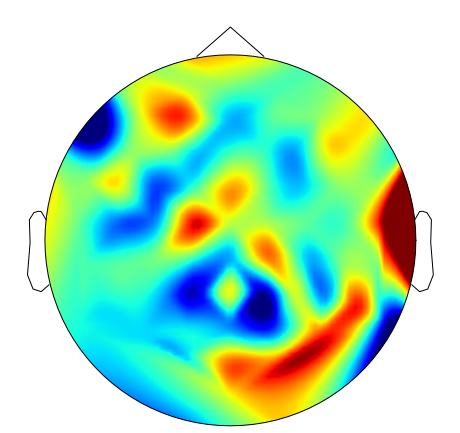

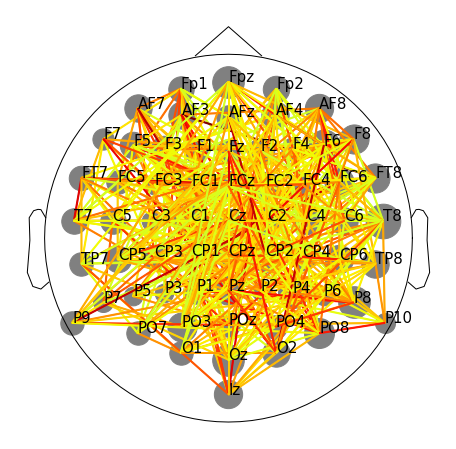

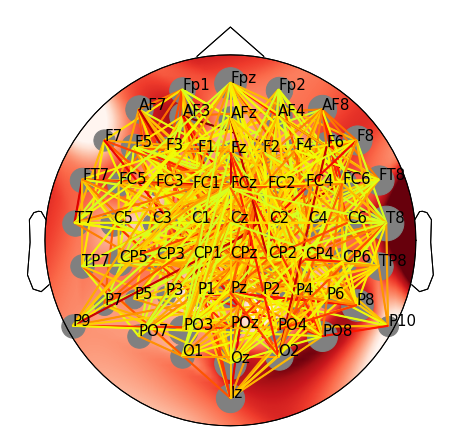

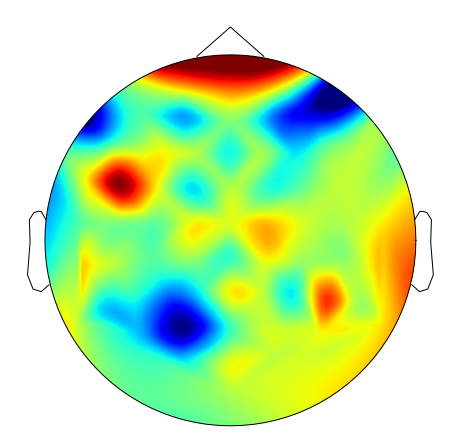

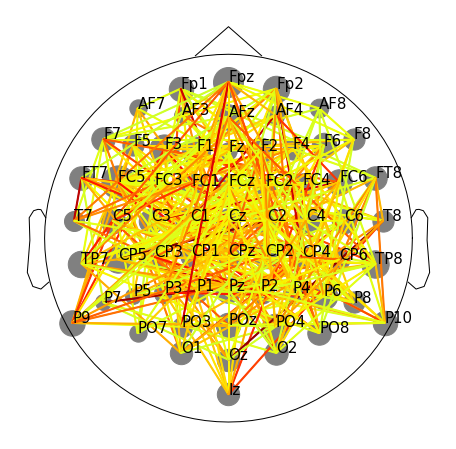

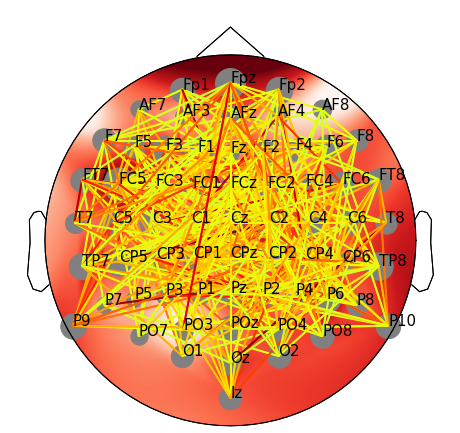

run:  2
Epoch 1/200
1/1 [==============================] - 1s 992ms/step - loss: 723.8812 - val_loss: 714.6341
Epoch 2/200
1/1 [==============================] - 0s 58ms/step - loss: 756.5670 - val_loss: 686.9560
Epoch 3/200
1/1 [==============================] - 0s 55ms/step - loss: 694.3231 - val_loss: 670.2701
Epoch 4/200
1/1 [==============================] - 0s 211ms/step - loss: 711.4932 - val_loss: 651.4044
Epoch 5/200
1/1 [==============================] - 0s 56ms/step - loss: 684.5991 - val_loss: 635.0646
Epoch 6/200
1/1 [==============================] - 0s 56ms/step - loss: 656.5375 - val_loss: 617.0287
Epoch 7/200
1/1 [==============================] - 0s 55ms/step - loss: 631.3085 - val_loss: 597.8348
Epoch 8/200
1/1 [==============================] - 0s 55ms/step - loss: 608.0926 - val_loss: 578.0689
Epoch 9/200
1/1 [==============================] - 0s 56ms/step - loss: 585.0391 - val_loss: 558.0203
Epoch 10/200
1/1 [==============================] - 0s 55ms/step - loss:

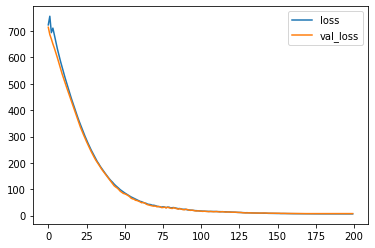

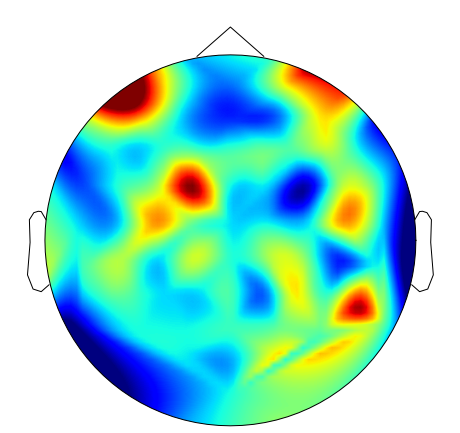

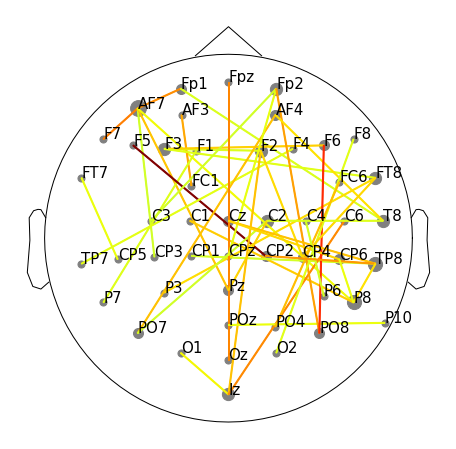

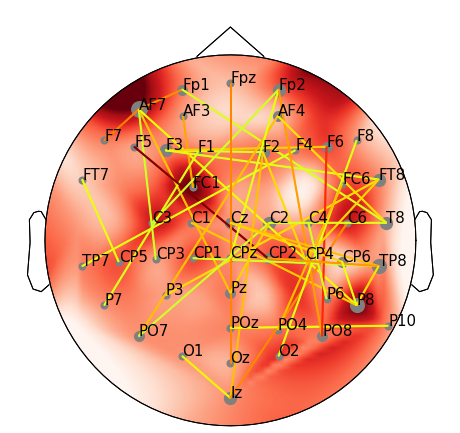

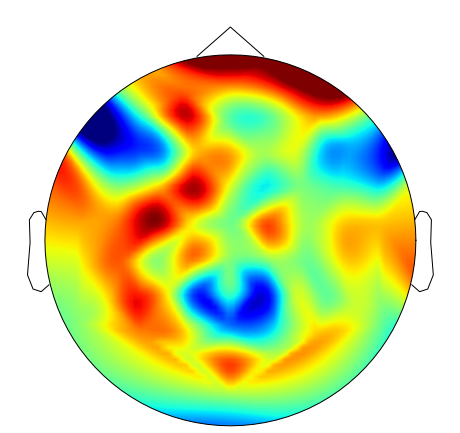

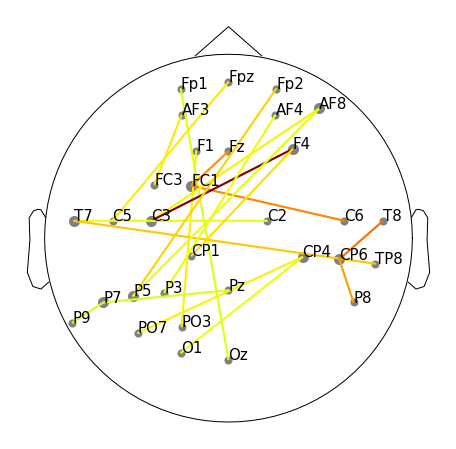

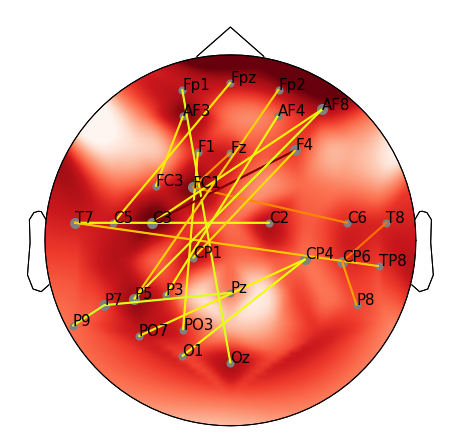

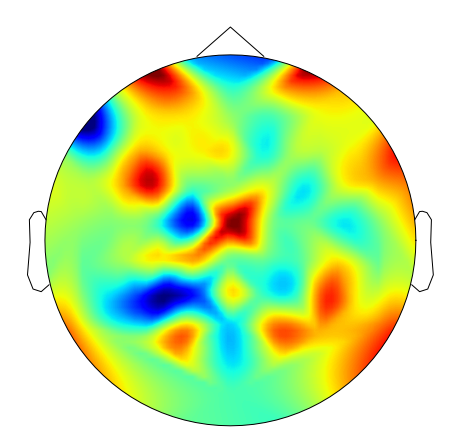

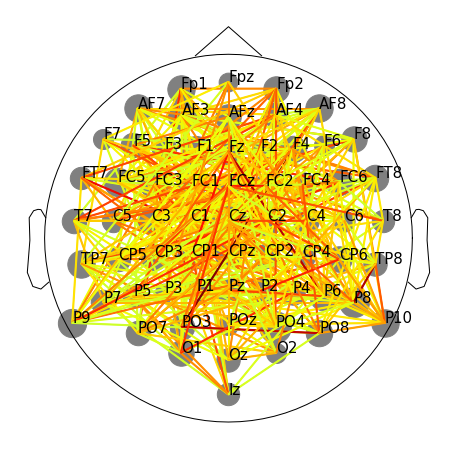

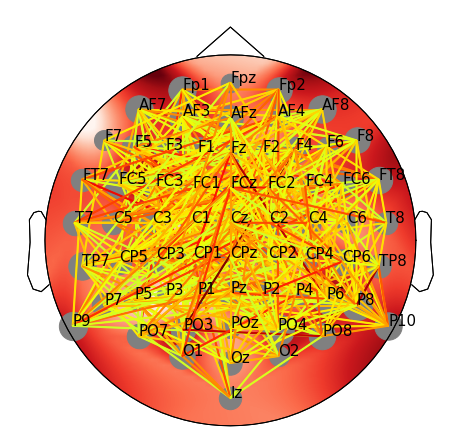

run:  3
Epoch 1/200
1/1 [==============================] - 1s 962ms/step - loss: 724.1138 - val_loss: 704.9424
Epoch 2/200
1/1 [==============================] - 0s 61ms/step - loss: 751.1679 - val_loss: 693.7594
Epoch 3/200
1/1 [==============================] - 0s 58ms/step - loss: 692.5986 - val_loss: 673.1478
Epoch 4/200
1/1 [==============================] - 0s 55ms/step - loss: 699.1006 - val_loss: 652.5563
Epoch 5/200
1/1 [==============================] - 0s 58ms/step - loss: 671.2879 - val_loss: 631.4354
Epoch 6/200
1/1 [==============================] - 0s 55ms/step - loss: 643.1653 - val_loss: 617.3058
Epoch 7/200
1/1 [==============================] - 0s 183ms/step - loss: 620.9694 - val_loss: 600.4740
Epoch 8/200
1/1 [==============================] - 0s 55ms/step - loss: 598.2704 - val_loss: 582.2173
Epoch 9/200
1/1 [==============================] - 0s 56ms/step - loss: 575.8972 - val_loss: 563.3262
Epoch 10/200
1/1 [==============================] - 0s 56ms/step - loss:

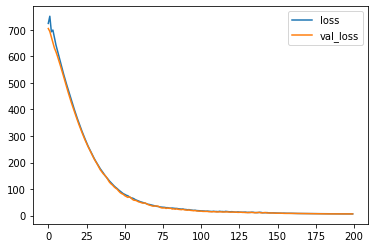

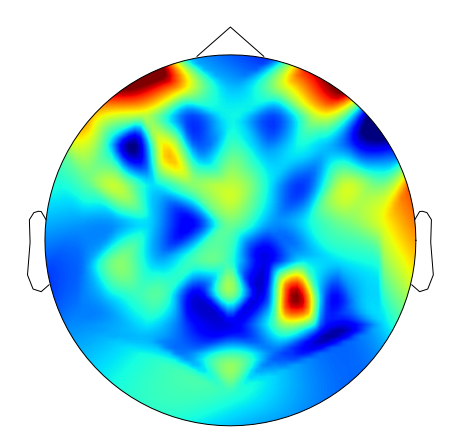

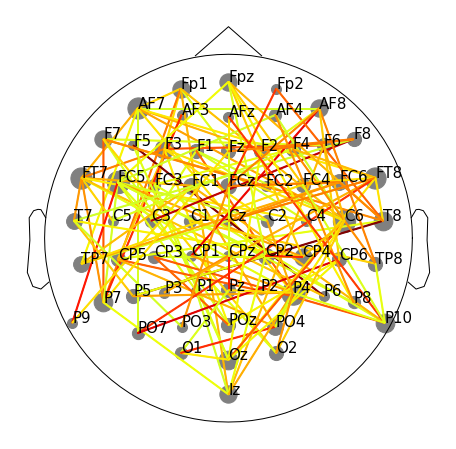

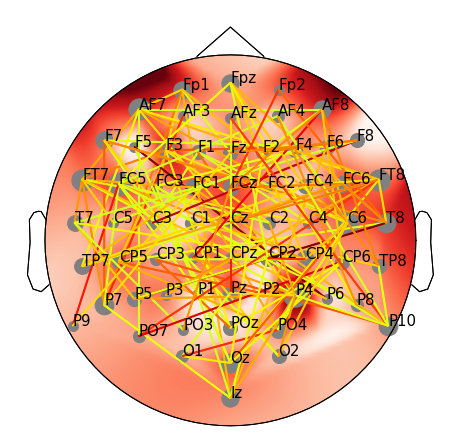

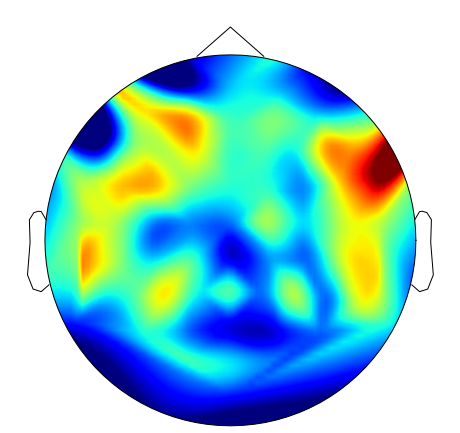

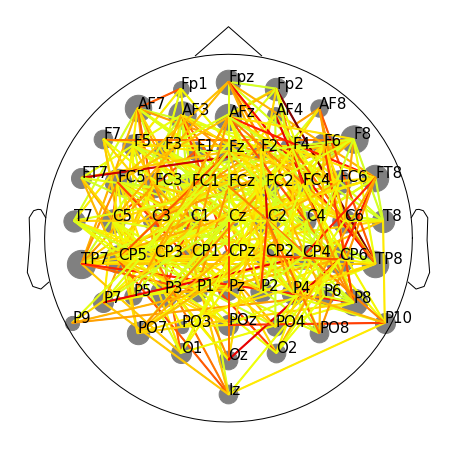

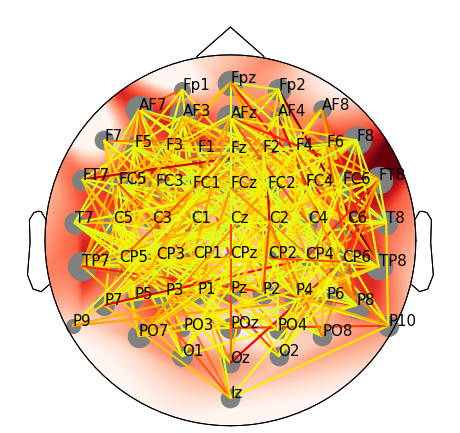

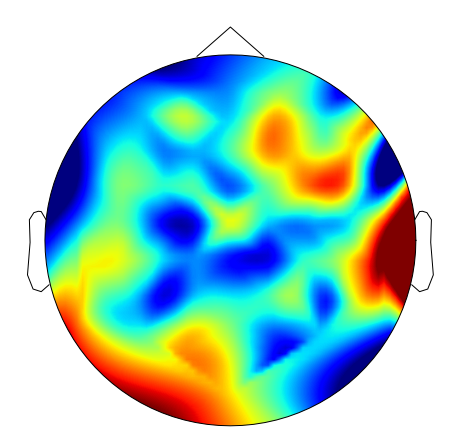

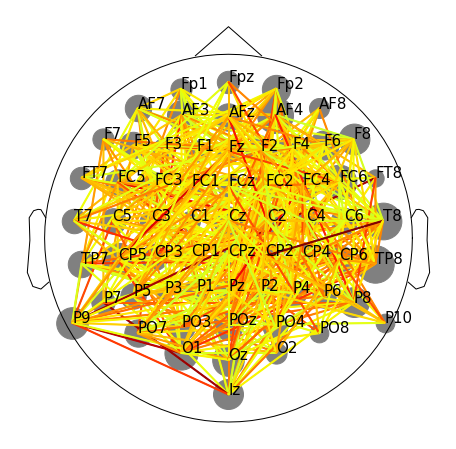

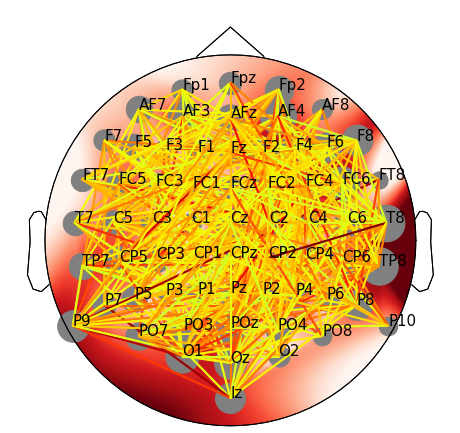

run:  4
Epoch 1/200
1/1 [==============================] - 1s 914ms/step - loss: 724.3268 - val_loss: 753.6824
Epoch 2/200
1/1 [==============================] - 0s 212ms/step - loss: 751.5132 - val_loss: 699.3817
Epoch 3/200
1/1 [==============================] - 0s 56ms/step - loss: 691.8773 - val_loss: 729.4957
Epoch 4/200
1/1 [==============================] - 0s 55ms/step - loss: 704.4319 - val_loss: 713.7076
Epoch 5/200
1/1 [==============================] - 0s 56ms/step - loss: 677.7405 - val_loss: 691.3513
Epoch 6/200
1/1 [==============================] - 0s 55ms/step - loss: 649.6755 - val_loss: 666.4642
Epoch 7/200
1/1 [==============================] - 0s 57ms/step - loss: 625.5645 - val_loss: 641.4294
Epoch 8/200
1/1 [==============================] - 0s 56ms/step - loss: 602.9408 - val_loss: 615.8545
Epoch 9/200
1/1 [==============================] - 0s 64ms/step - loss: 579.9442 - val_loss: 590.3260
Epoch 10/200
1/1 [==============================] - 0s 56ms/step - loss:

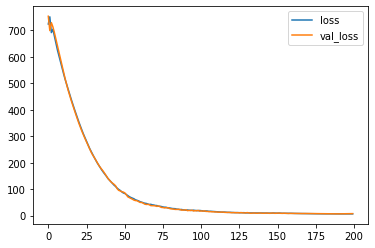

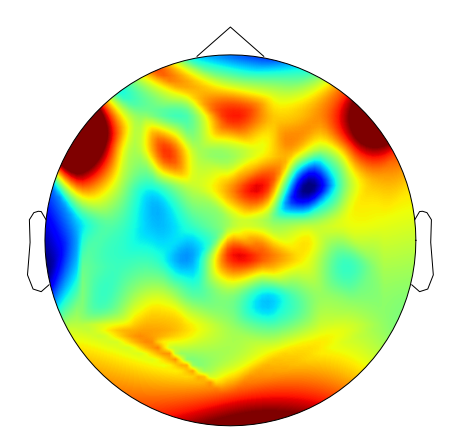

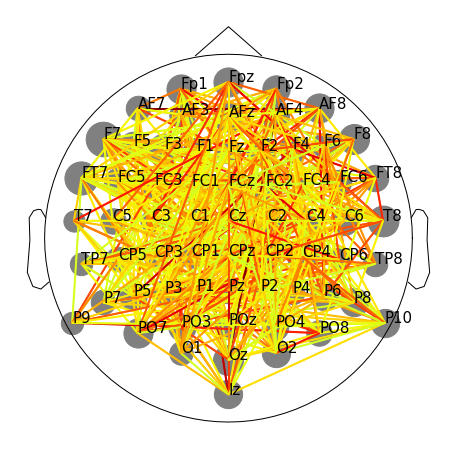

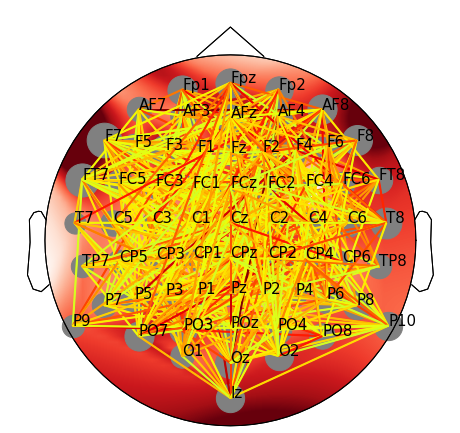

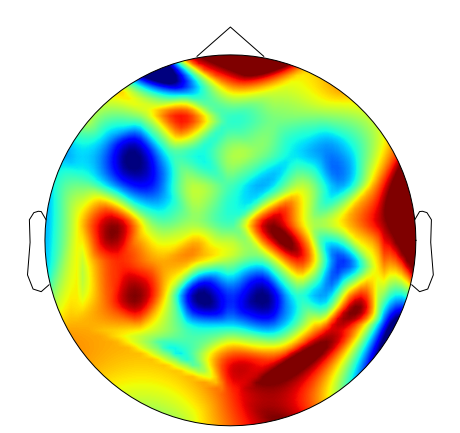

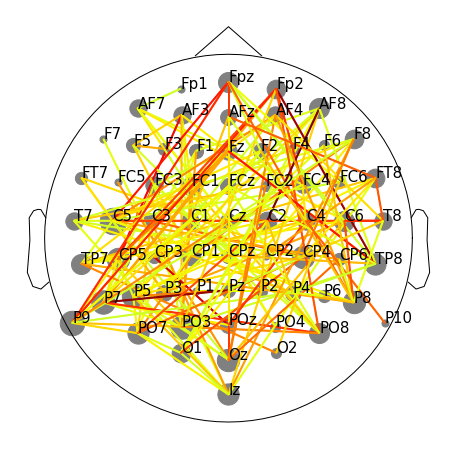

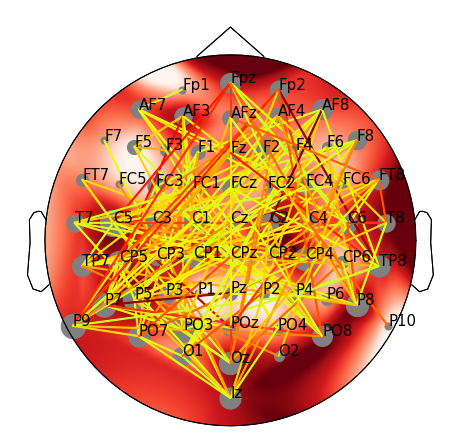

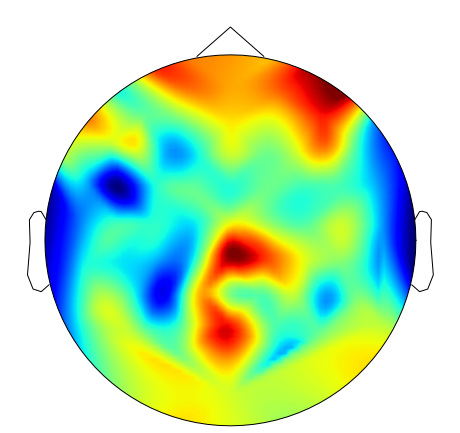

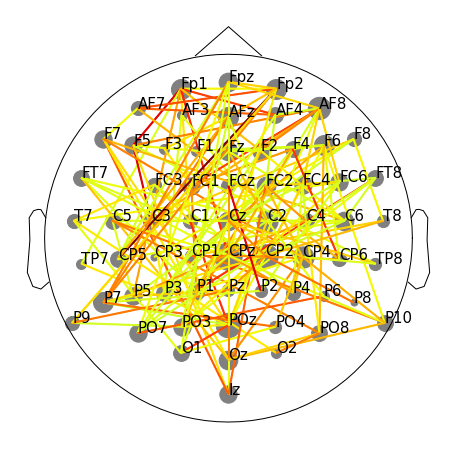

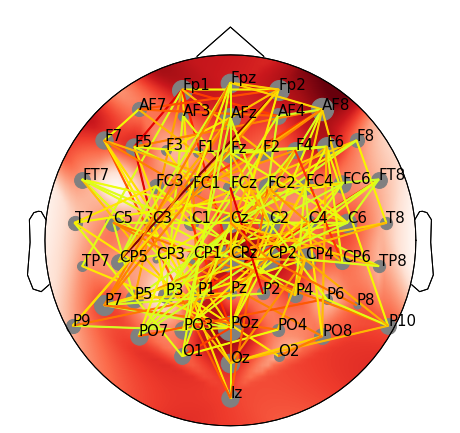

run:  5
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 723.8999 - val_loss: 726.9794
Epoch 2/200
1/1 [==============================] - 0s 61ms/step - loss: 754.5677 - val_loss: 690.2173
Epoch 3/200
1/1 [==============================] - 0s 60ms/step - loss: 693.1655 - val_loss: 708.3552
Epoch 4/200
1/1 [==============================] - 0s 60ms/step - loss: 706.9889 - val_loss: 694.1615
Epoch 5/200
1/1 [==============================] - 0s 60ms/step - loss: 679.9006 - val_loss: 671.1145
Epoch 6/200
1/1 [==============================] - 0s 57ms/step - loss: 651.9443 - val_loss: 646.1840
Epoch 7/200
1/1 [==============================] - 0s 57ms/step - loss: 627.3385 - val_loss: 621.0496
Epoch 8/200
1/1 [==============================] - 0s 57ms/step - loss: 604.6679 - val_loss: 596.2814
Epoch 9/200
1/1 [==============================] - 0s 69ms/step - loss: 582.1914 - val_loss: 572.1253
Epoch 10/200
1/1 [==============================] - 0s 57ms/step - loss: 561

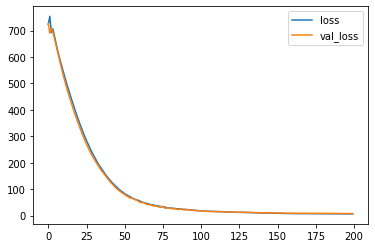

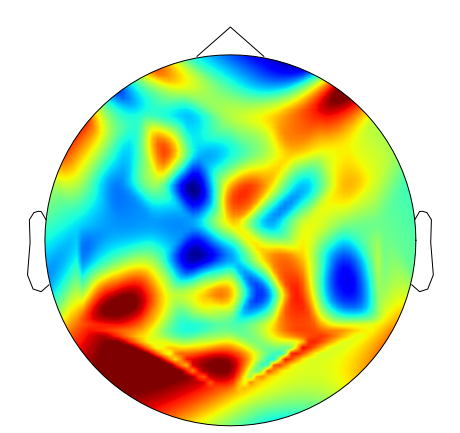

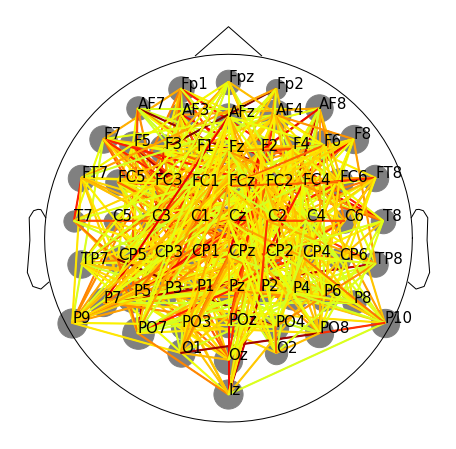

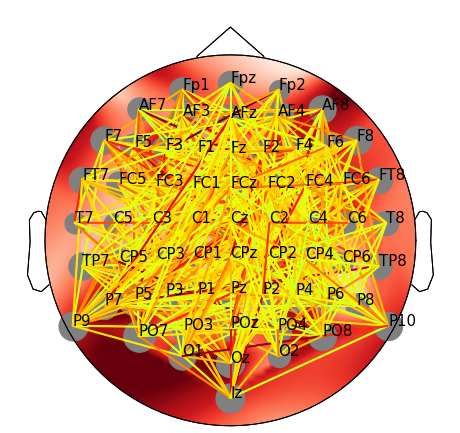

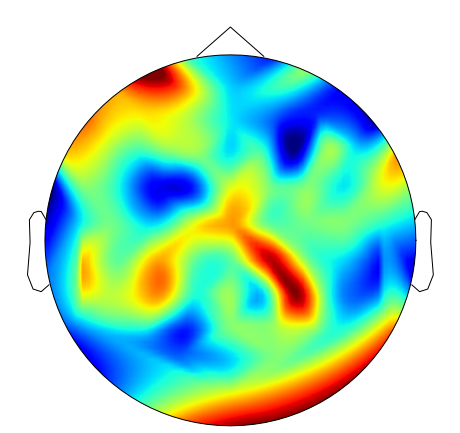

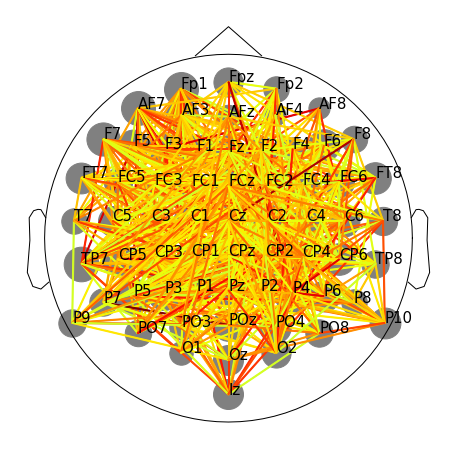

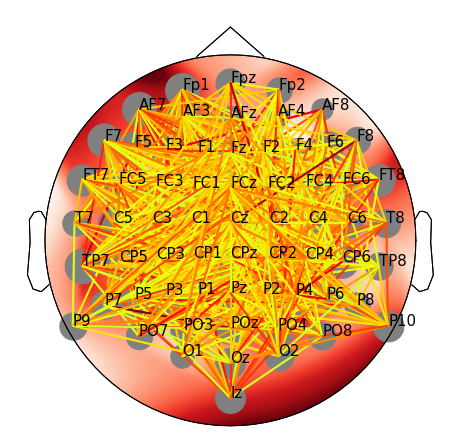

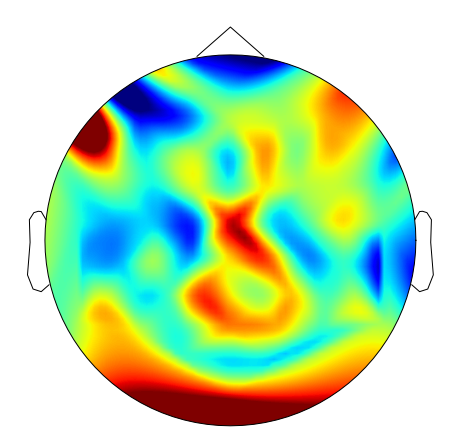

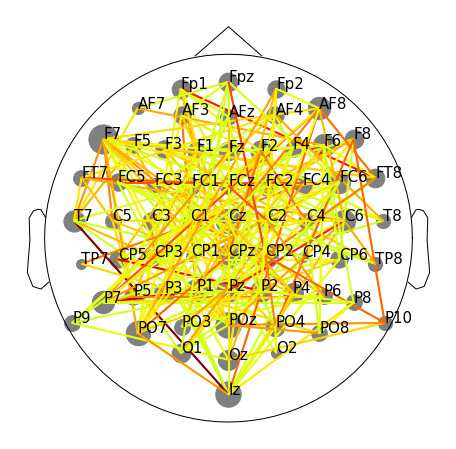

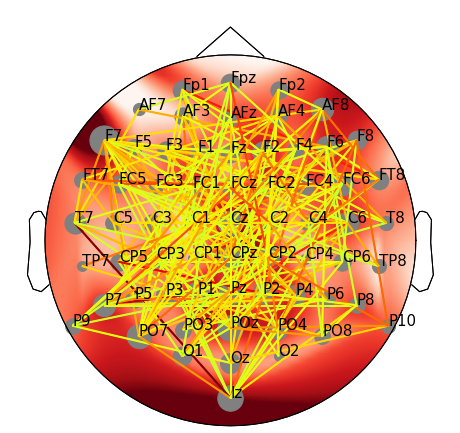

grupos:  [0, None, None]
run:  1
Epoch 1/200
1/1 [==============================] - 1s 926ms/step - loss: 723.6821 - val_loss: 712.6478
Epoch 2/200
1/1 [==============================] - 0s 59ms/step - loss: 740.6669 - val_loss: 678.8191
Epoch 3/200
1/1 [==============================] - 0s 213ms/step - loss: 680.1943 - val_loss: 664.5051
Epoch 4/200
1/1 [==============================] - 0s 60ms/step - loss: 689.2913 - val_loss: 646.1705
Epoch 5/200
1/1 [==============================] - 0s 56ms/step - loss: 661.9413 - val_loss: 622.2996
Epoch 6/200
1/1 [==============================] - 0s 55ms/step - loss: 631.0439 - val_loss: 598.7186
Epoch 7/200
1/1 [==============================] - 0s 60ms/step - loss: 603.1313 - val_loss: 575.5859
Epoch 8/200
1/1 [==============================] - 0s 58ms/step - loss: 577.6456 - val_loss: 552.2195
Epoch 9/200
1/1 [==============================] - 0s 57ms/step - loss: 553.2456 - val_loss: 530.0763
Epoch 10/200
1/1 [=============================

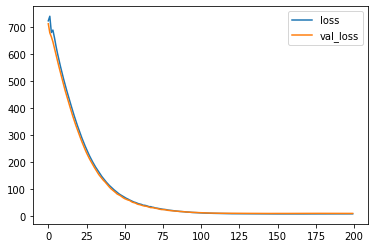

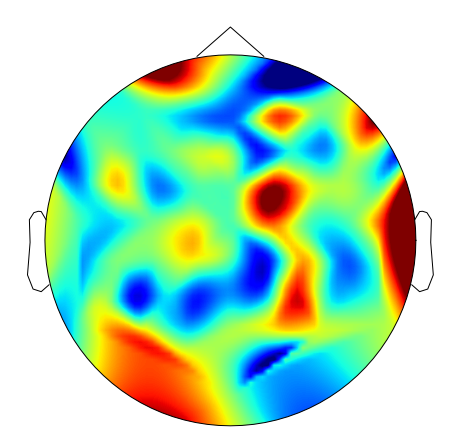

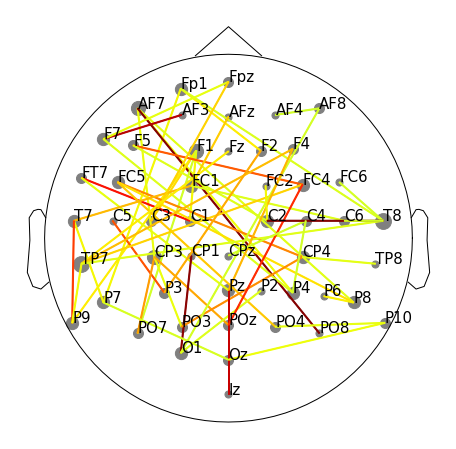

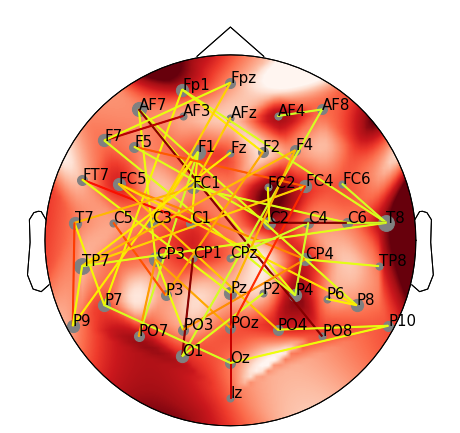

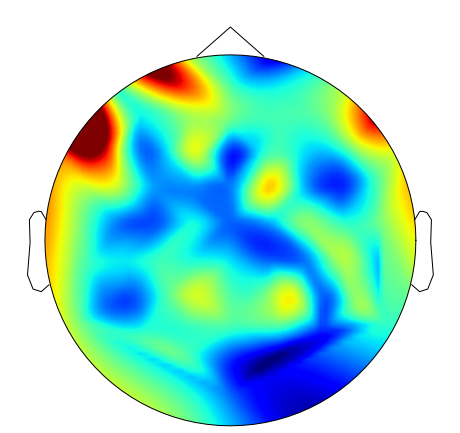

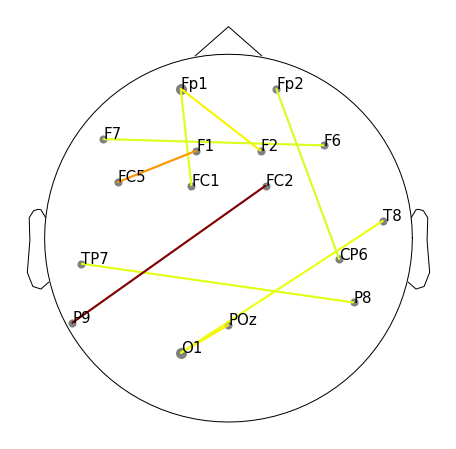

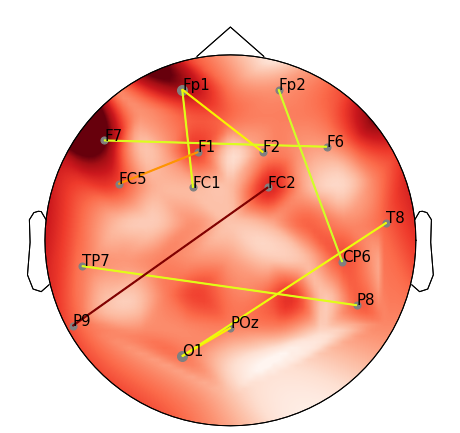

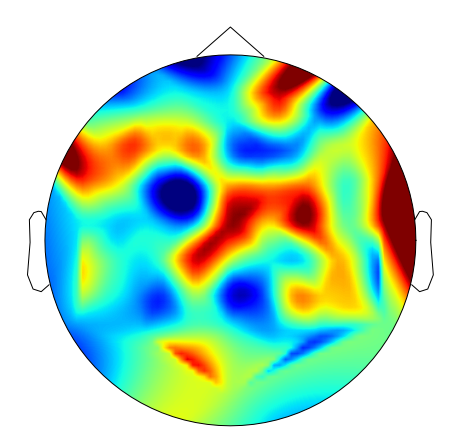

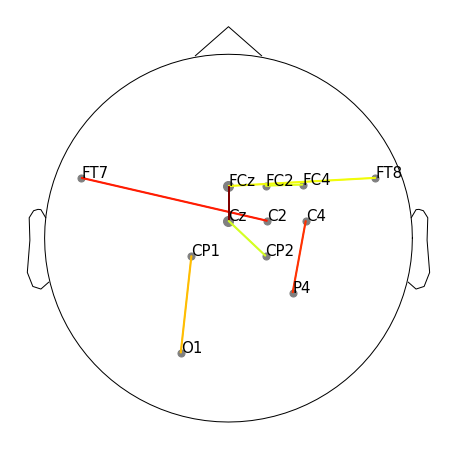

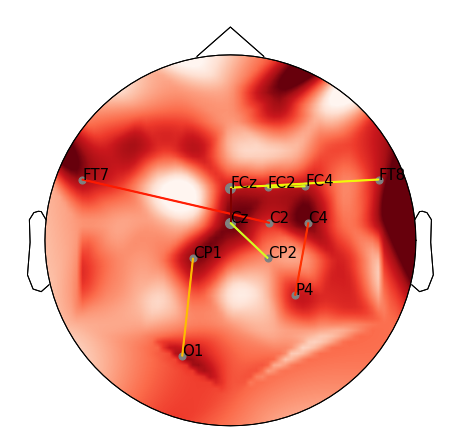

run:  2
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 723.9717 - val_loss: 703.7481
Epoch 2/200
1/1 [==============================] - 0s 63ms/step - loss: 739.4781 - val_loss: 682.1337
Epoch 3/200
1/1 [==============================] - 0s 56ms/step - loss: 680.6417 - val_loss: 669.5751
Epoch 4/200
1/1 [==============================] - 0s 56ms/step - loss: 689.9032 - val_loss: 650.3757
Epoch 5/200
1/1 [==============================] - 0s 59ms/step - loss: 662.7403 - val_loss: 625.9083
Epoch 6/200
1/1 [==============================] - 0s 57ms/step - loss: 630.2628 - val_loss: 600.3005
Epoch 7/200
1/1 [==============================] - 0s 62ms/step - loss: 602.9046 - val_loss: 575.7131
Epoch 8/200
1/1 [==============================] - 0s 59ms/step - loss: 577.6224 - val_loss: 552.1093
Epoch 9/200
1/1 [==============================] - 0s 57ms/step - loss: 552.9479 - val_loss: 529.3992
Epoch 10/200
1/1 [==============================] - 0s 59ms/step - loss: 529

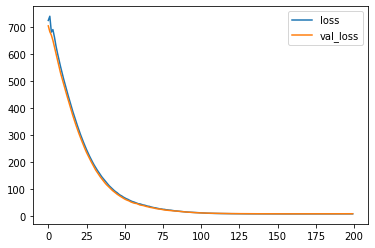

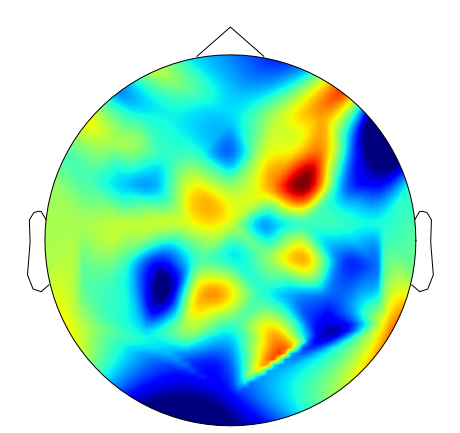

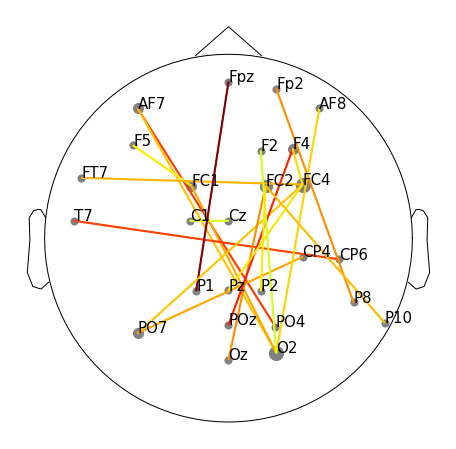

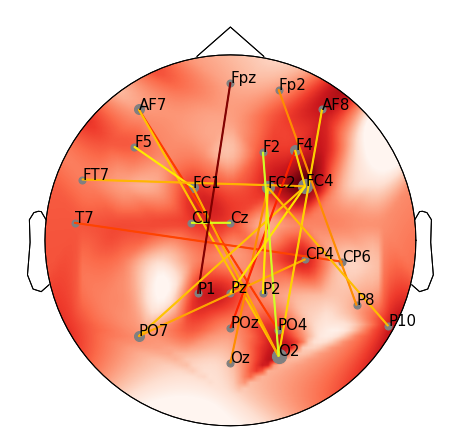

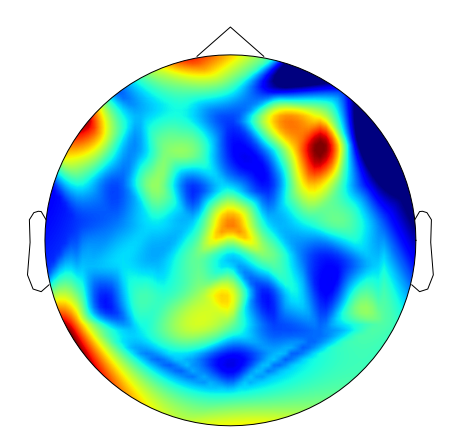

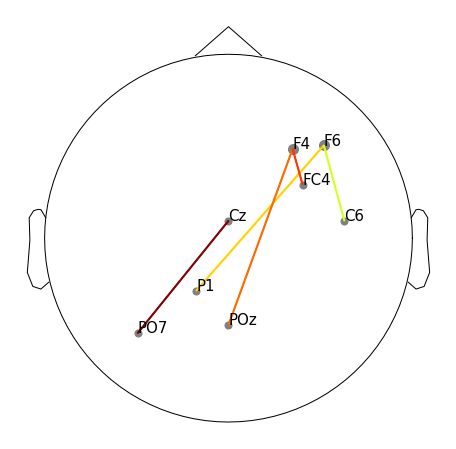

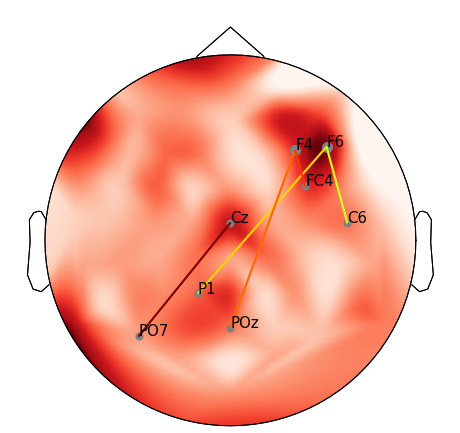

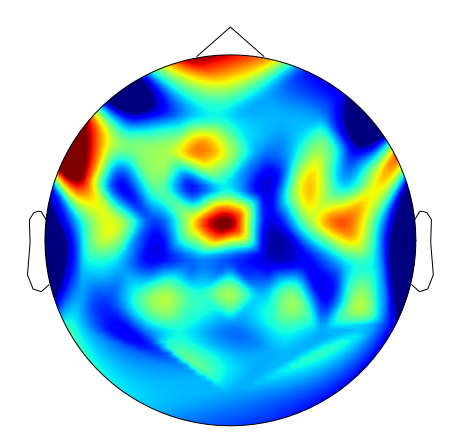

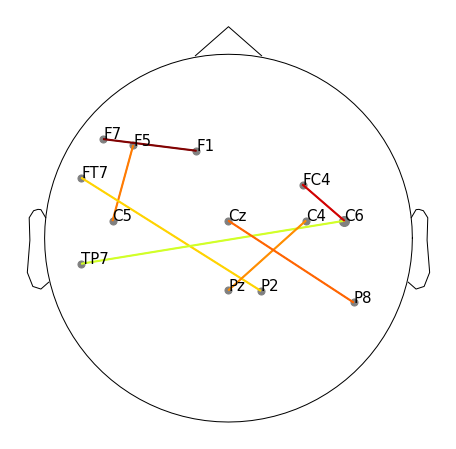

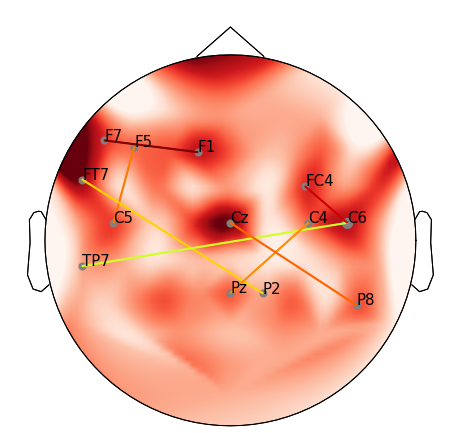

run:  3
Epoch 1/200
1/1 [==============================] - 1s 959ms/step - loss: 724.1848 - val_loss: 715.1630
Epoch 2/200
1/1 [==============================] - 0s 61ms/step - loss: 741.3760 - val_loss: 680.8568
Epoch 3/200
1/1 [==============================] - 0s 57ms/step - loss: 681.7367 - val_loss: 684.1434
Epoch 4/200
1/1 [==============================] - 0s 57ms/step - loss: 693.7368 - val_loss: 666.9038
Epoch 5/200
1/1 [==============================] - 0s 56ms/step - loss: 666.9240 - val_loss: 642.8878
Epoch 6/200
1/1 [==============================] - 0s 60ms/step - loss: 634.7577 - val_loss: 614.9274
Epoch 7/200
1/1 [==============================] - 0s 62ms/step - loss: 606.2810 - val_loss: 587.3874
Epoch 8/200
1/1 [==============================] - 0s 185ms/step - loss: 580.8030 - val_loss: 560.4561
Epoch 9/200
1/1 [==============================] - 0s 58ms/step - loss: 556.1238 - val_loss: 534.7844
Epoch 10/200
1/1 [==============================] - 0s 57ms/step - loss:

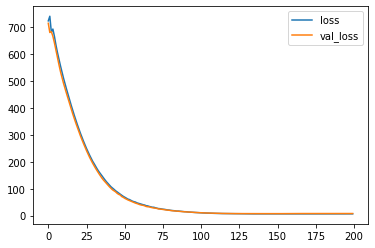

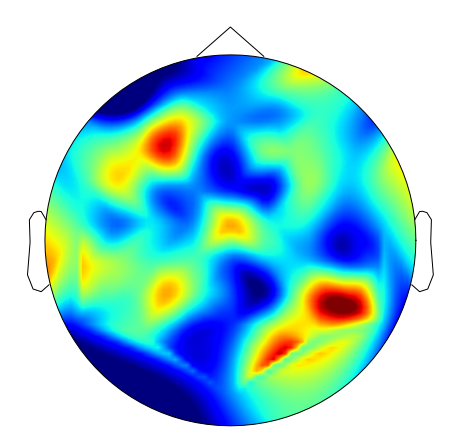

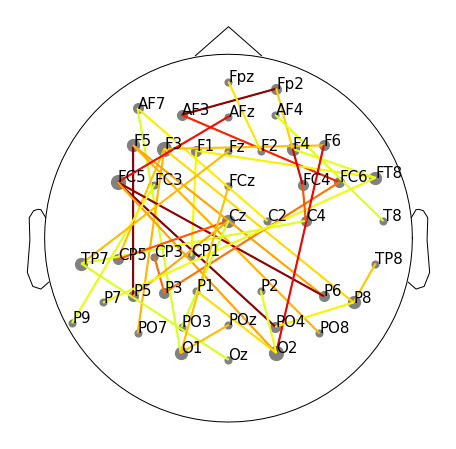

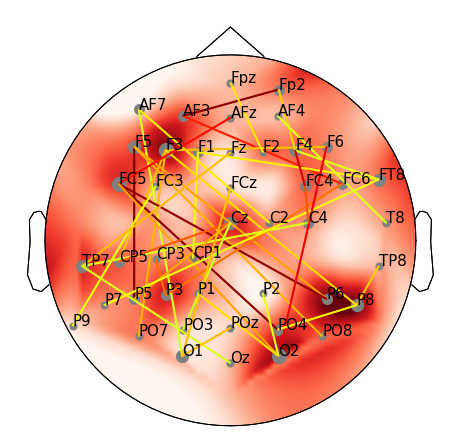

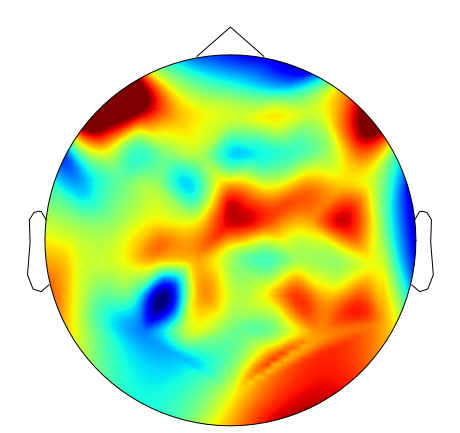

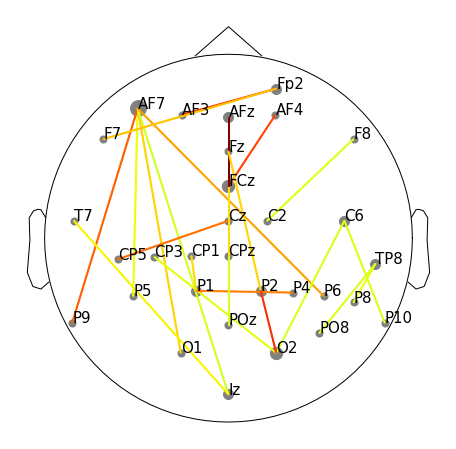

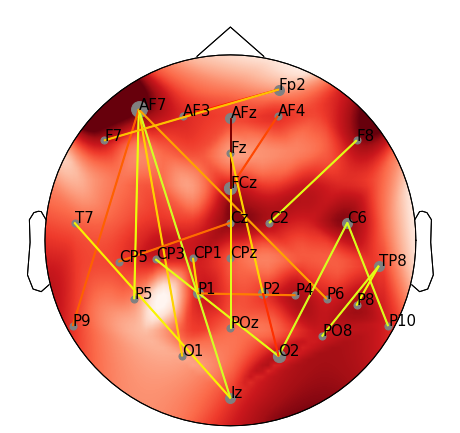

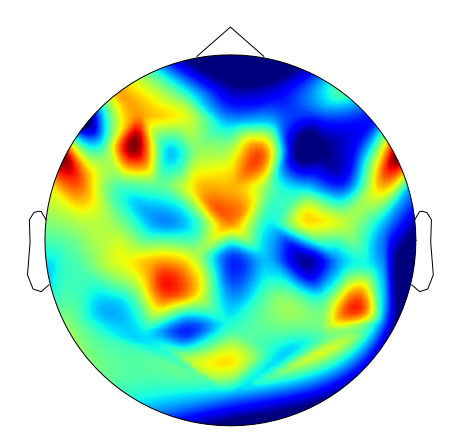

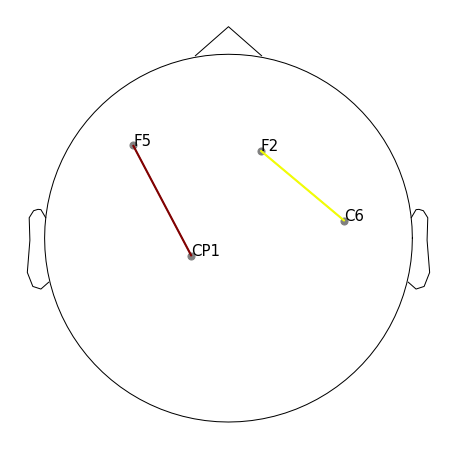

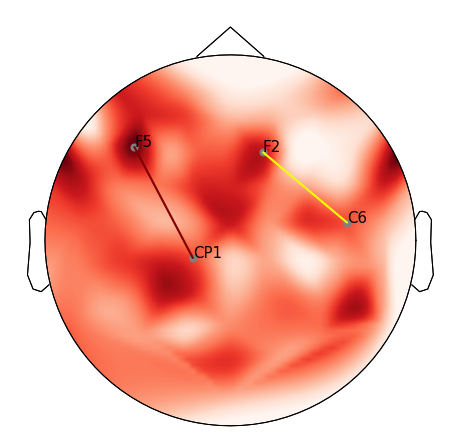

run:  4
Epoch 1/200
1/1 [==============================] - 1s 941ms/step - loss: 723.9098 - val_loss: 711.9933
Epoch 2/200
1/1 [==============================] - 0s 59ms/step - loss: 738.8397 - val_loss: 679.4727
Epoch 3/200
1/1 [==============================] - 0s 223ms/step - loss: 681.3168 - val_loss: 661.6820
Epoch 4/200
1/1 [==============================] - 0s 59ms/step - loss: 678.8978 - val_loss: 640.0168
Epoch 5/200
1/1 [==============================] - 0s 56ms/step - loss: 652.9666 - val_loss: 619.2407
Epoch 6/200
1/1 [==============================] - 0s 59ms/step - loss: 623.8599 - val_loss: 596.6709
Epoch 7/200
1/1 [==============================] - 0s 61ms/step - loss: 597.7018 - val_loss: 574.4105
Epoch 8/200
1/1 [==============================] - 0s 56ms/step - loss: 572.8016 - val_loss: 552.3593
Epoch 9/200
1/1 [==============================] - 0s 55ms/step - loss: 548.8752 - val_loss: 530.6110
Epoch 10/200
1/1 [==============================] - 0s 60ms/step - loss:

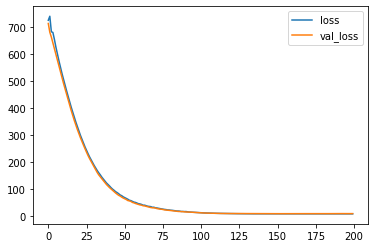

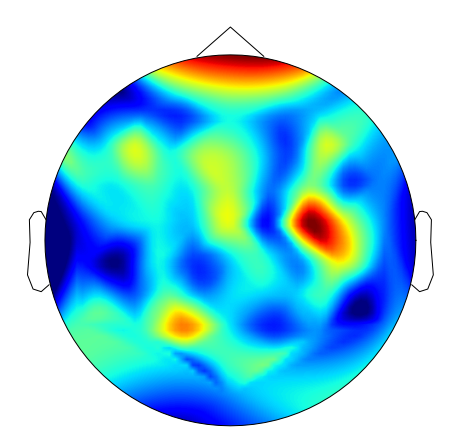

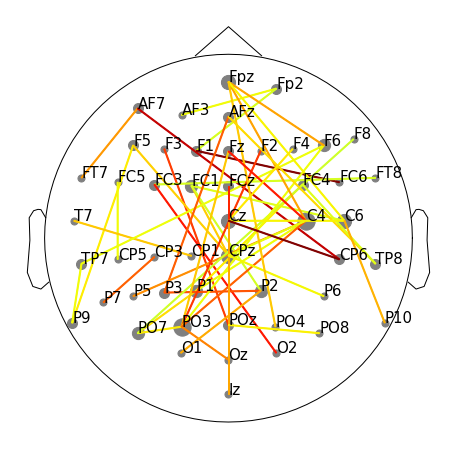

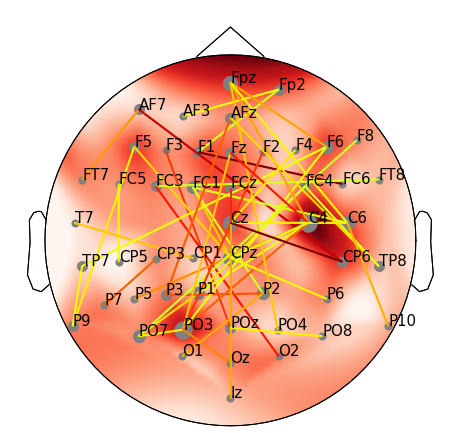

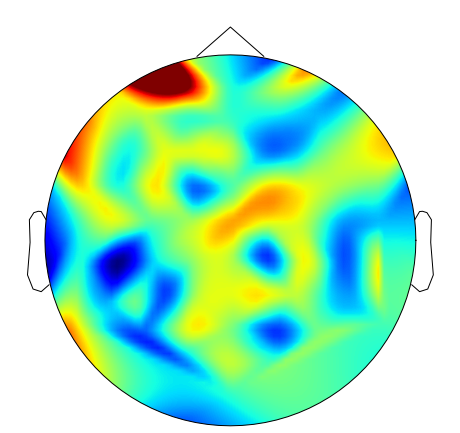

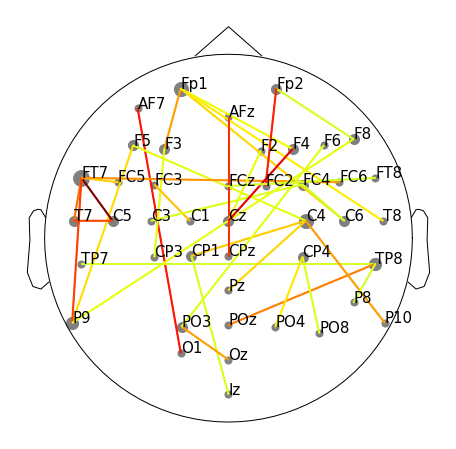

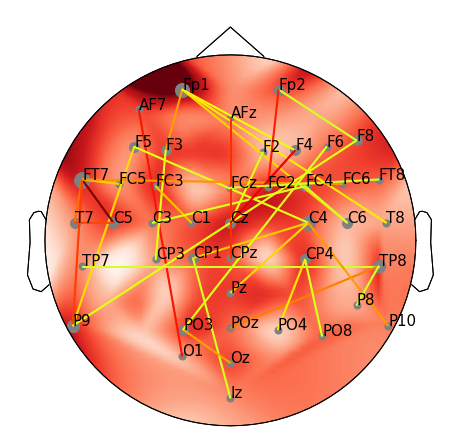

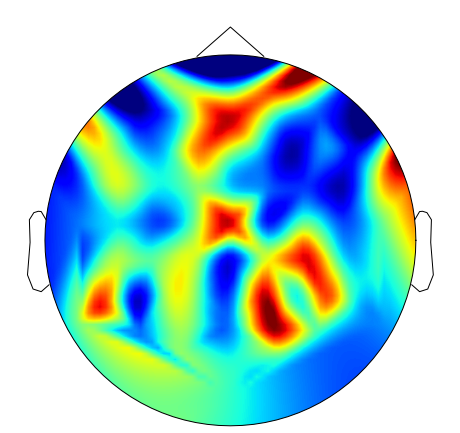

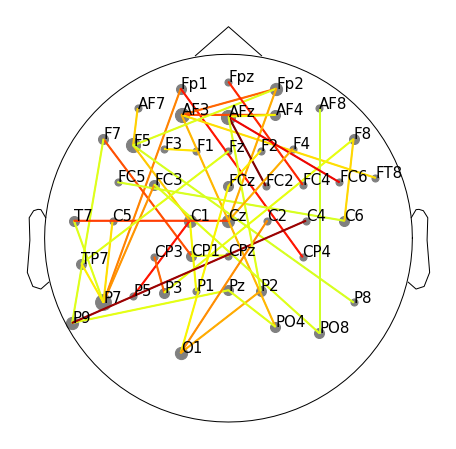

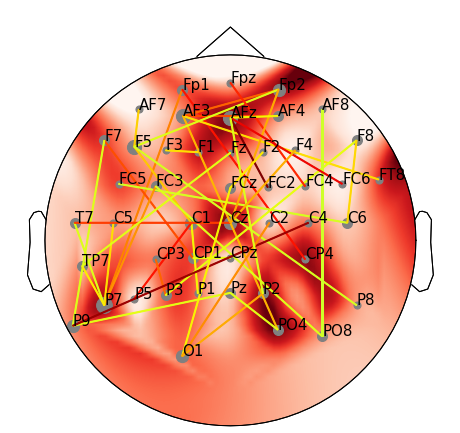

run:  5
Epoch 1/200
1/1 [==============================] - 1s 929ms/step - loss: 724.0344 - val_loss: 706.9987
Epoch 2/200
1/1 [==============================] - 0s 63ms/step - loss: 738.8696 - val_loss: 679.5085
Epoch 3/200
1/1 [==============================] - 0s 59ms/step - loss: 681.3265 - val_loss: 667.0406
Epoch 4/200
1/1 [==============================] - 0s 57ms/step - loss: 686.7961 - val_loss: 646.0239
Epoch 5/200
1/1 [==============================] - 0s 58ms/step - loss: 659.6591 - val_loss: 624.6023
Epoch 6/200
1/1 [==============================] - 0s 58ms/step - loss: 629.3459 - val_loss: 601.4822
Epoch 7/200
1/1 [==============================] - 0s 58ms/step - loss: 601.9010 - val_loss: 577.9796
Epoch 8/200
1/1 [==============================] - 0s 57ms/step - loss: 575.4125 - val_loss: 554.7358
Epoch 9/200
1/1 [==============================] - 0s 61ms/step - loss: 551.4019 - val_loss: 532.0021
Epoch 10/200
1/1 [==============================] - 0s 56ms/step - loss: 

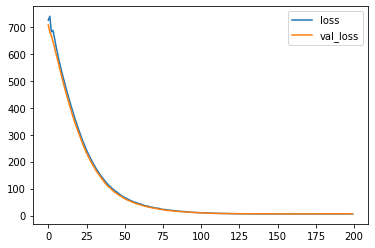

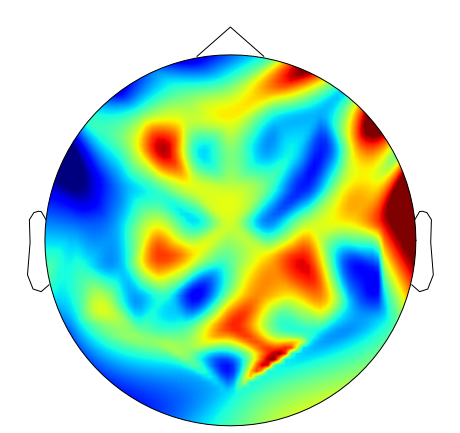

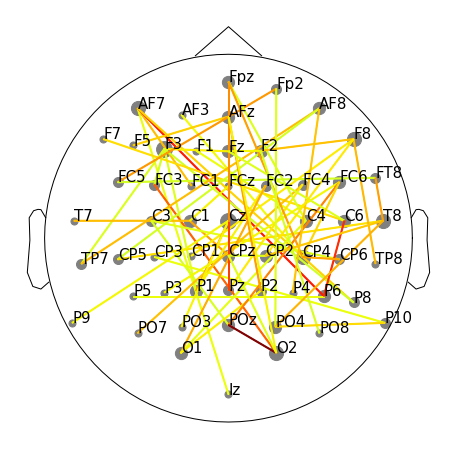

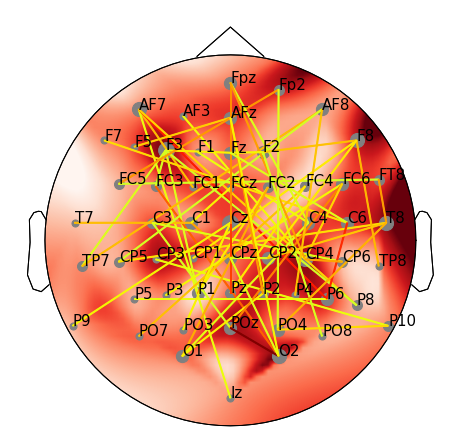

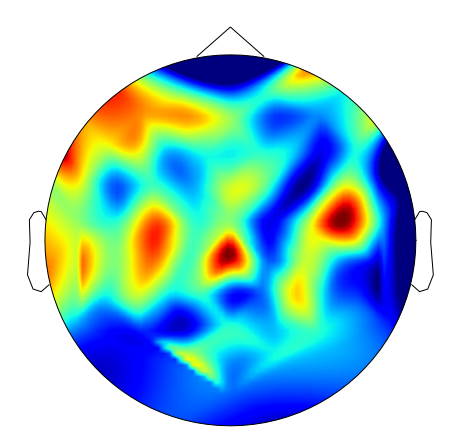

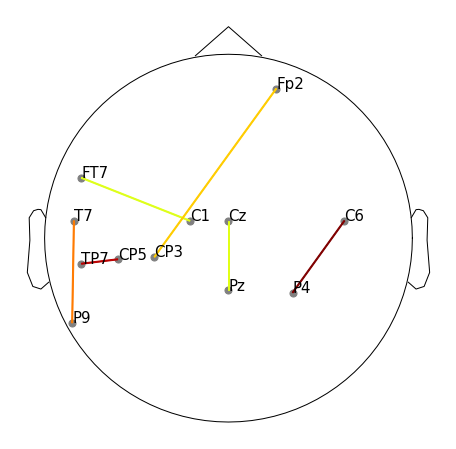

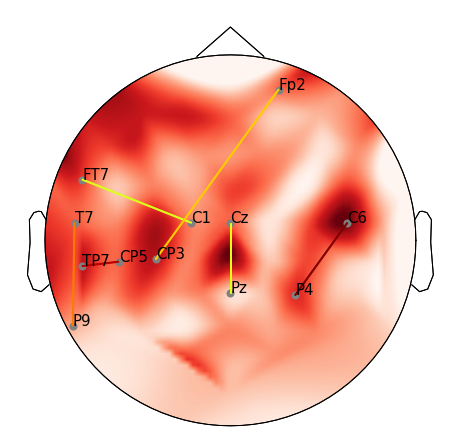

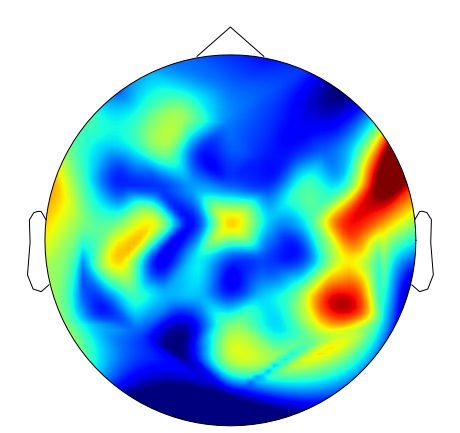

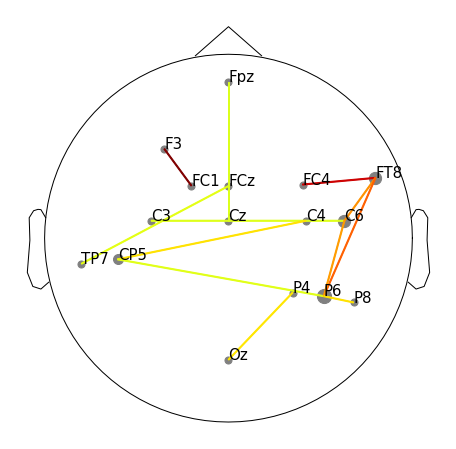

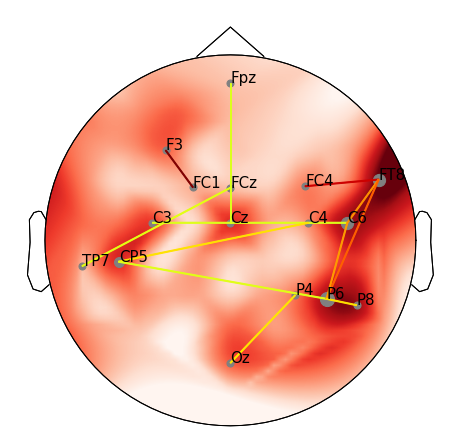

grupos:  [1, None, None]
run:  1
Epoch 1/200
1/1 [==============================] - 1s 917ms/step - loss: 723.8740 - val_loss: 700.3035
Epoch 2/200
1/1 [==============================] - 0s 60ms/step - loss: 728.1914 - val_loss: 670.3433
Epoch 3/200
1/1 [==============================] - 0s 57ms/step - loss: 670.7639 - val_loss: 647.9047
Epoch 4/200
1/1 [==============================] - 0s 59ms/step - loss: 666.3409 - val_loss: 621.2788
Epoch 5/200
1/1 [==============================] - 0s 191ms/step - loss: 639.6080 - val_loss: 595.1335
Epoch 6/200
1/1 [==============================] - 0s 57ms/step - loss: 608.1556 - val_loss: 572.5296
Epoch 7/200
1/1 [==============================] - 0s 57ms/step - loss: 579.2131 - val_loss: 550.3040
Epoch 8/200
1/1 [==============================] - 0s 59ms/step - loss: 551.4765 - val_loss: 527.3146
Epoch 9/200
1/1 [==============================] - 0s 58ms/step - loss: 525.1465 - val_loss: 505.9010
Epoch 10/200
1/1 [=============================

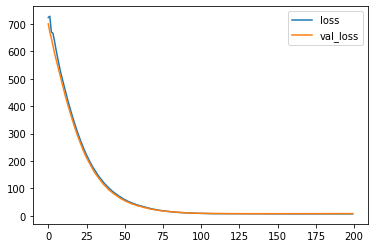

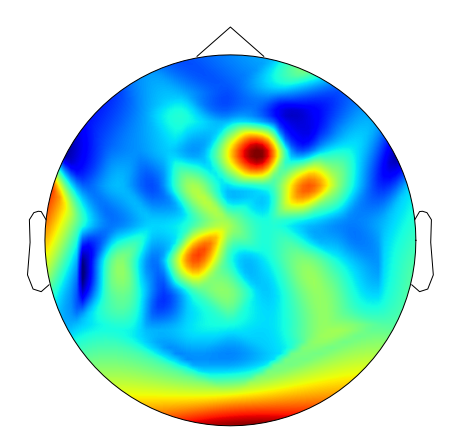

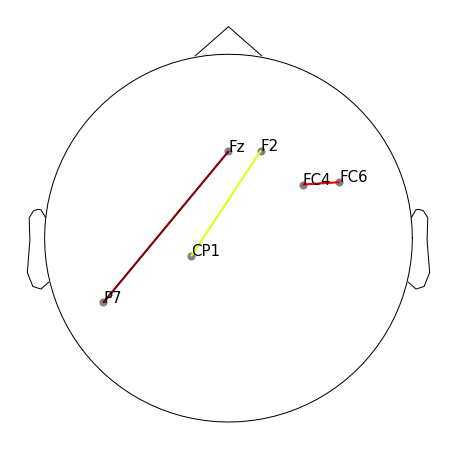

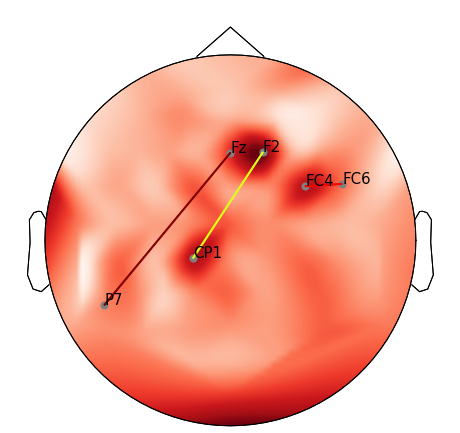

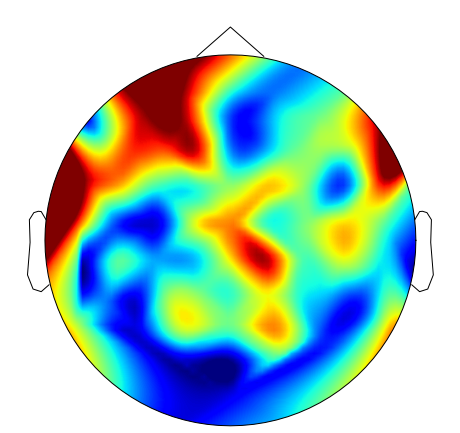

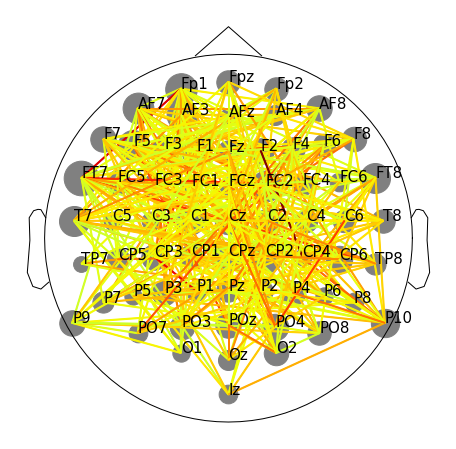

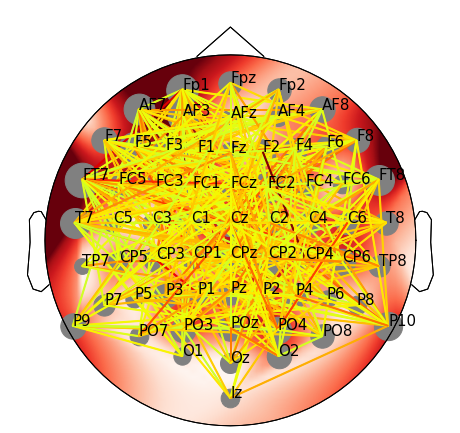

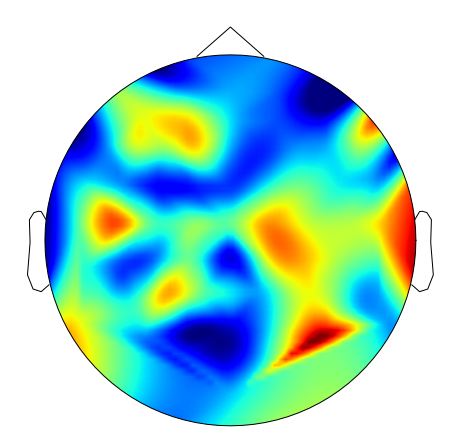

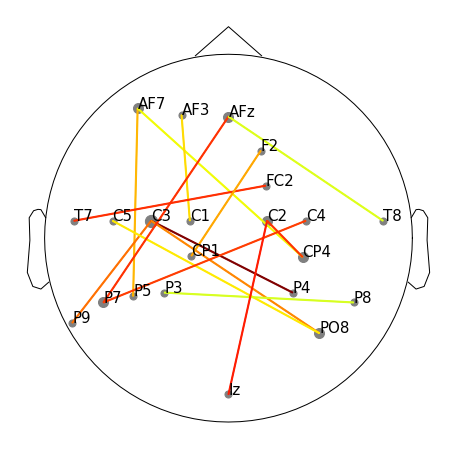

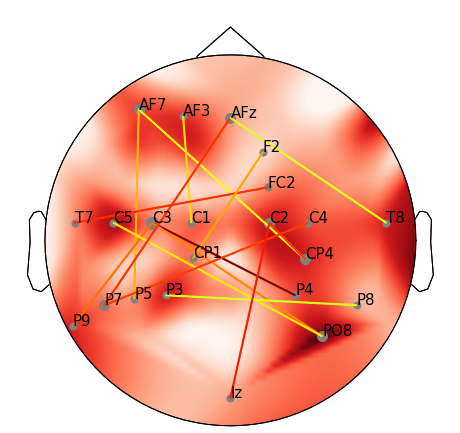

run:  2
Epoch 1/200
1/1 [==============================] - 1s 919ms/step - loss: 723.8391 - val_loss: 702.8273
Epoch 2/200
1/1 [==============================] - 0s 59ms/step - loss: 732.1829 - val_loss: 672.4907
Epoch 3/200
1/1 [==============================] - 0s 57ms/step - loss: 675.1650 - val_loss: 660.1815
Epoch 4/200
1/1 [==============================] - 0s 57ms/step - loss: 673.7991 - val_loss: 636.4852
Epoch 5/200
1/1 [==============================] - 0s 58ms/step - loss: 647.3289 - val_loss: 606.0098
Epoch 6/200
1/1 [==============================] - 0s 56ms/step - loss: 615.1395 - val_loss: 578.6290
Epoch 7/200
1/1 [==============================] - 0s 58ms/step - loss: 587.3619 - val_loss: 554.2978
Epoch 8/200
1/1 [==============================] - 0s 60ms/step - loss: 560.4339 - val_loss: 533.3801
Epoch 9/200
1/1 [==============================] - 0s 58ms/step - loss: 534.4684 - val_loss: 512.3542
Epoch 10/200
1/1 [==============================] - 0s 56ms/step - loss: 

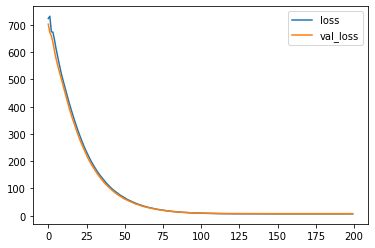

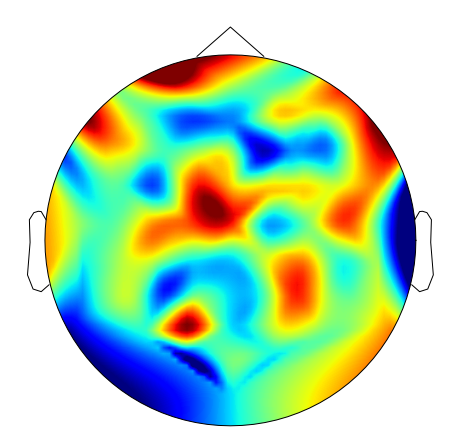

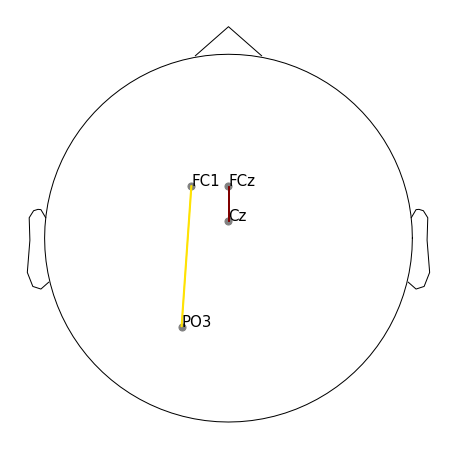

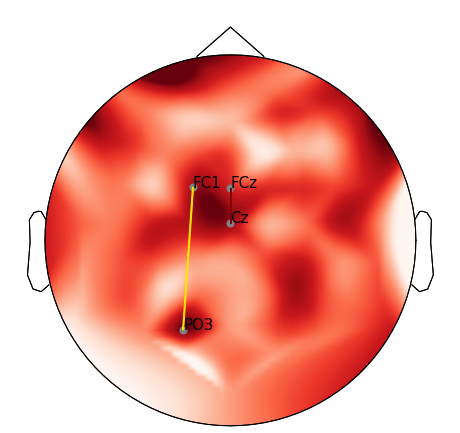

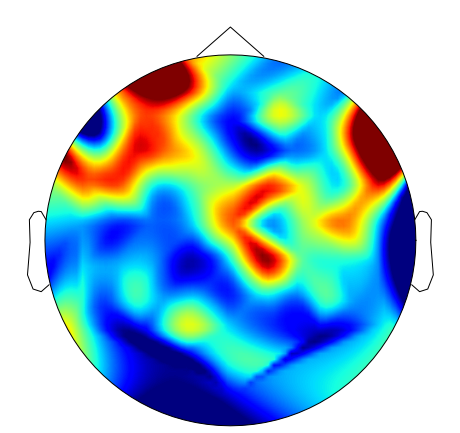

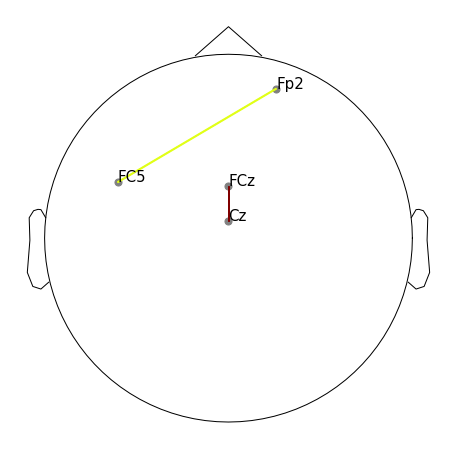

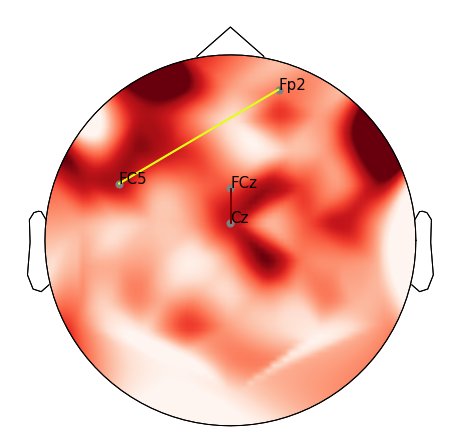

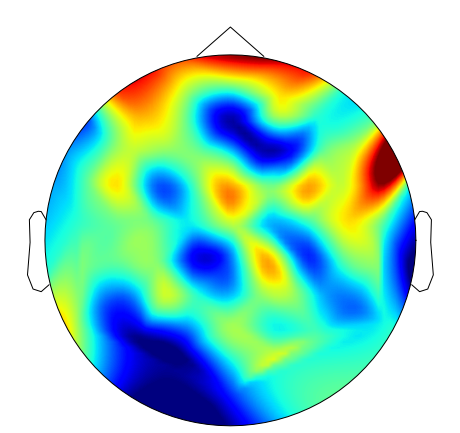

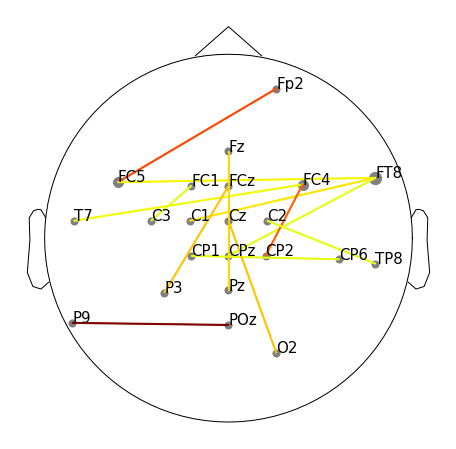

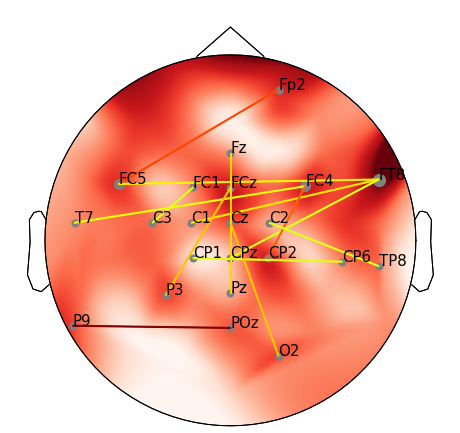

run:  3
Epoch 1/200
1/1 [==============================] - 1s 930ms/step - loss: 723.8311 - val_loss: 697.7927
Epoch 2/200
1/1 [==============================] - 0s 58ms/step - loss: 729.2043 - val_loss: 669.9064
Epoch 3/200
1/1 [==============================] - 0s 56ms/step - loss: 671.2513 - val_loss: 647.6781
Epoch 4/200
1/1 [==============================] - 0s 56ms/step - loss: 668.9974 - val_loss: 626.3079
Epoch 5/200
1/1 [==============================] - 0s 56ms/step - loss: 642.9825 - val_loss: 602.4153
Epoch 6/200
1/1 [==============================] - 0s 57ms/step - loss: 609.8893 - val_loss: 577.1225
Epoch 7/200
1/1 [==============================] - 0s 188ms/step - loss: 579.5478 - val_loss: 550.0582
Epoch 8/200
1/1 [==============================] - 0s 59ms/step - loss: 552.1882 - val_loss: 525.9830
Epoch 9/200
1/1 [==============================] - 0s 59ms/step - loss: 526.7366 - val_loss: 503.3928
Epoch 10/200
1/1 [==============================] - 0s 56ms/step - loss:

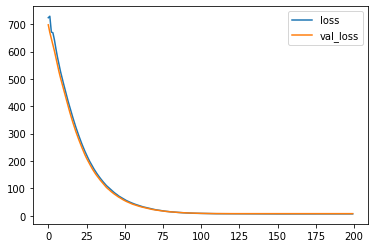

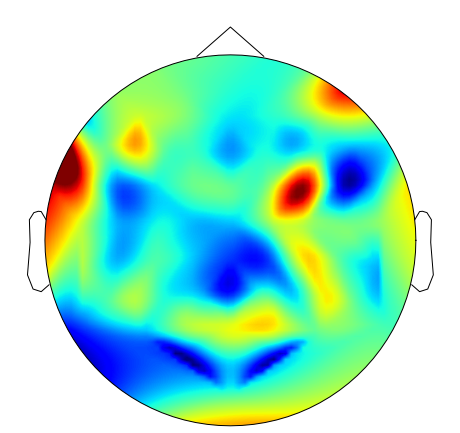

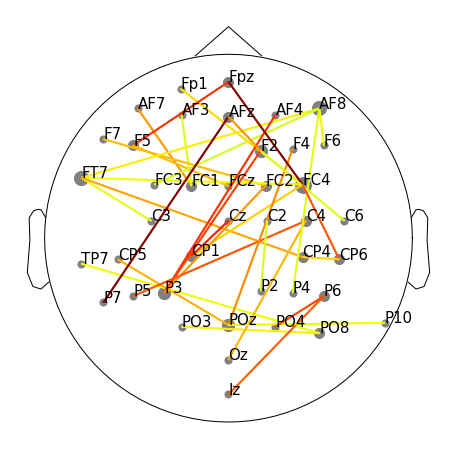

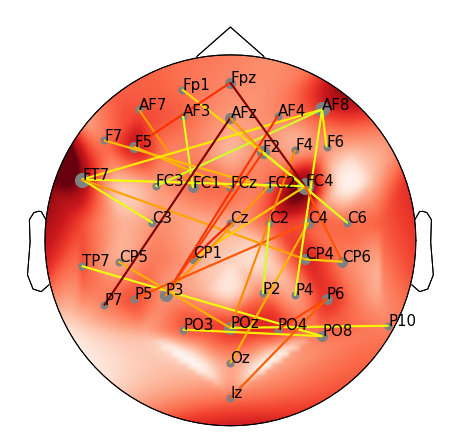

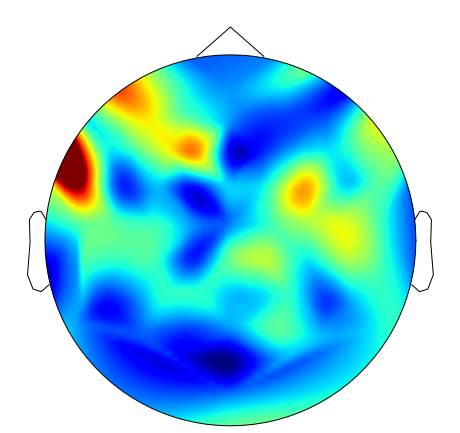

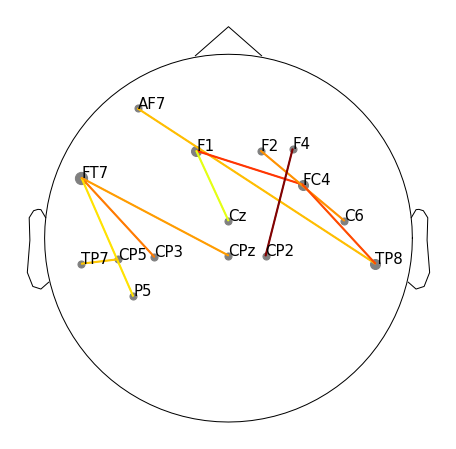

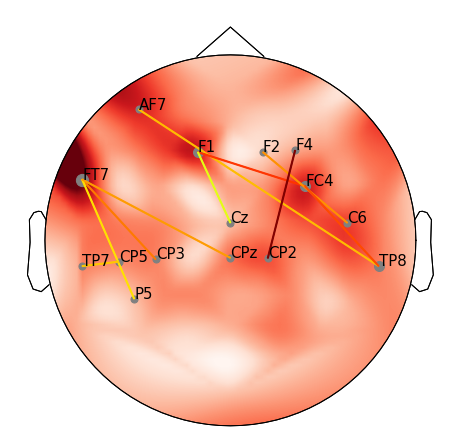

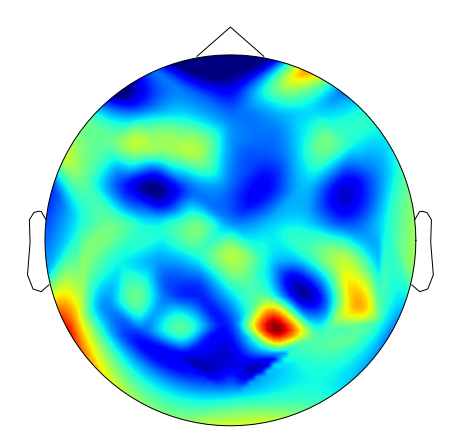

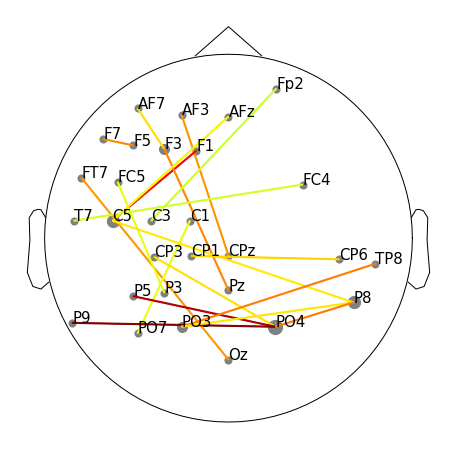

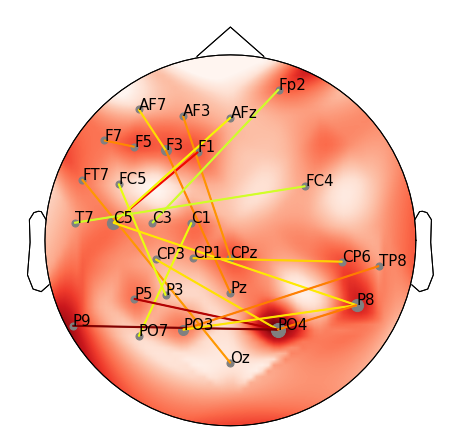

run:  4
Epoch 1/200
1/1 [==============================] - 1s 911ms/step - loss: 723.8420 - val_loss: 705.8725
Epoch 2/200
1/1 [==============================] - 0s 225ms/step - loss: 728.5850 - val_loss: 671.8813
Epoch 3/200
1/1 [==============================] - 0s 57ms/step - loss: 672.0126 - val_loss: 658.3233
Epoch 4/200
1/1 [==============================] - 0s 57ms/step - loss: 670.0504 - val_loss: 628.1249
Epoch 5/200
1/1 [==============================] - 0s 56ms/step - loss: 641.9092 - val_loss: 600.5001
Epoch 6/200
1/1 [==============================] - 0s 57ms/step - loss: 611.8080 - val_loss: 575.9500
Epoch 7/200
1/1 [==============================] - 0s 58ms/step - loss: 583.0043 - val_loss: 553.8192
Epoch 8/200
1/1 [==============================] - 0s 56ms/step - loss: 554.4271 - val_loss: 530.5643
Epoch 9/200
1/1 [==============================] - 0s 58ms/step - loss: 528.5435 - val_loss: 507.6854
Epoch 10/200
1/1 [==============================] - 0s 56ms/step - loss:

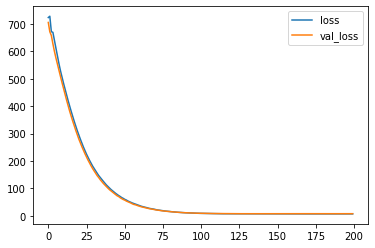

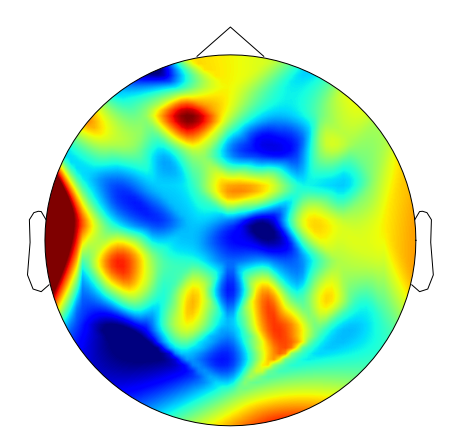

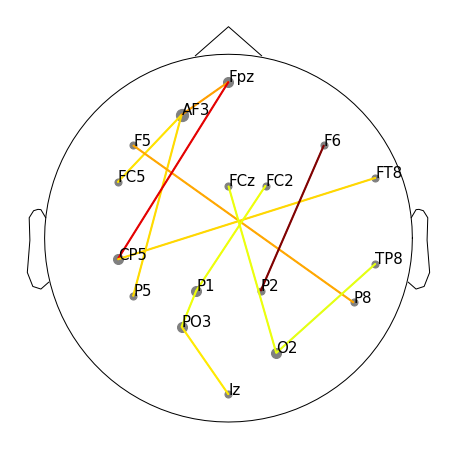

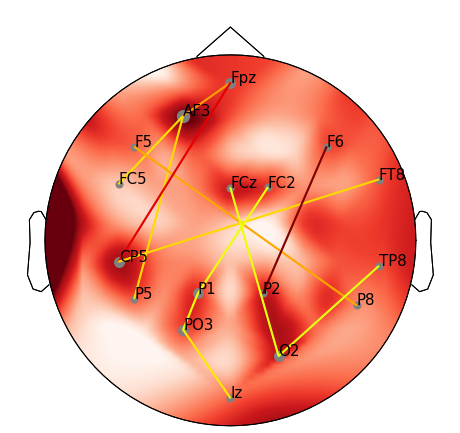

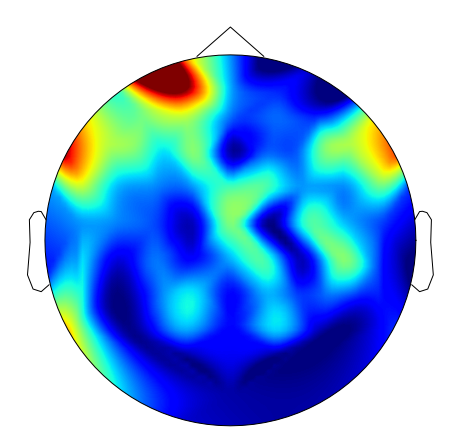

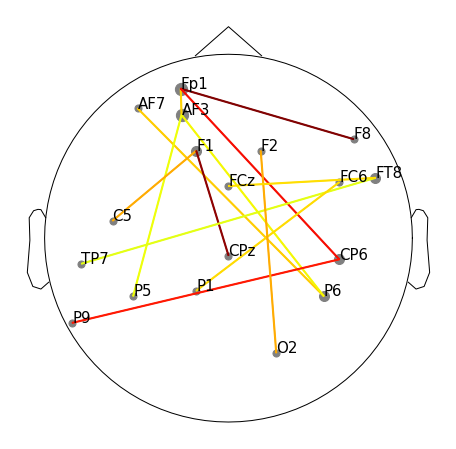

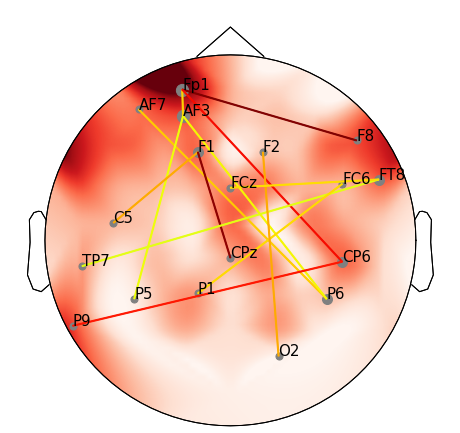

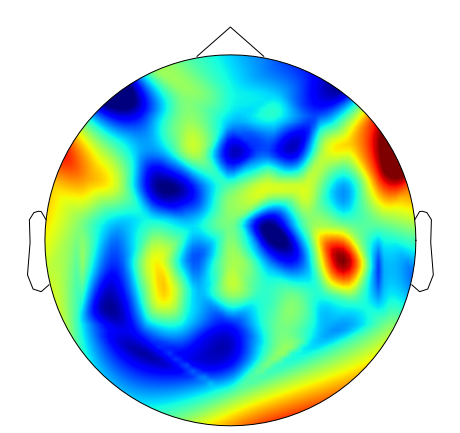

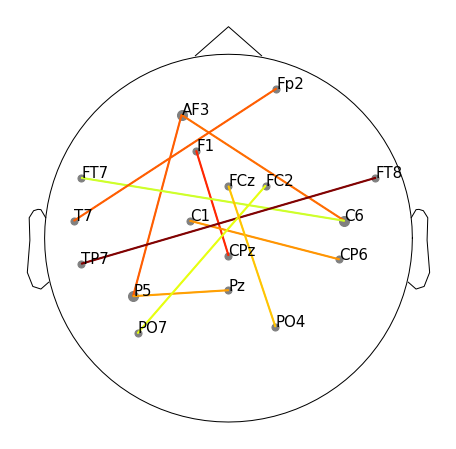

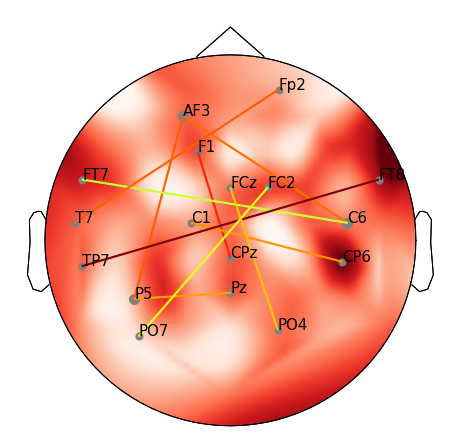

run:  5
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 723.6697 - val_loss: 714.0500
Epoch 2/200
1/1 [==============================] - 0s 61ms/step - loss: 732.3434 - val_loss: 673.2355
Epoch 3/200
1/1 [==============================] - 0s 57ms/step - loss: 676.8225 - val_loss: 676.5839
Epoch 4/200
1/1 [==============================] - 0s 57ms/step - loss: 672.1144 - val_loss: 650.0421
Epoch 5/200
1/1 [==============================] - 0s 58ms/step - loss: 645.9169 - val_loss: 615.0463
Epoch 6/200
1/1 [==============================] - 0s 58ms/step - loss: 615.6220 - val_loss: 582.2855
Epoch 7/200
1/1 [==============================] - 0s 59ms/step - loss: 586.2566 - val_loss: 552.4640
Epoch 8/200
1/1 [==============================] - 0s 58ms/step - loss: 557.8785 - val_loss: 532.8495
Epoch 9/200
1/1 [==============================] - 0s 58ms/step - loss: 531.8685 - val_loss: 513.5380
Epoch 10/200
1/1 [==============================] - 0s 57ms/step - loss: 509

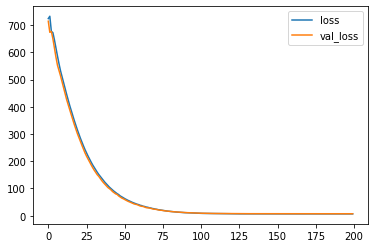

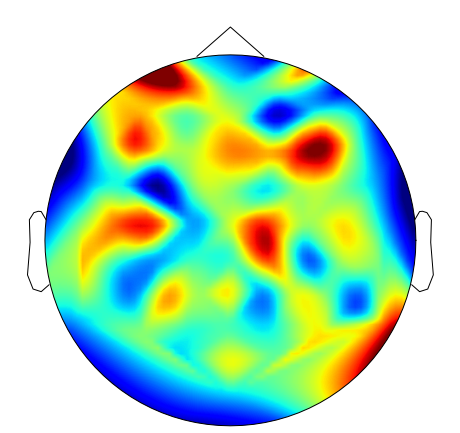

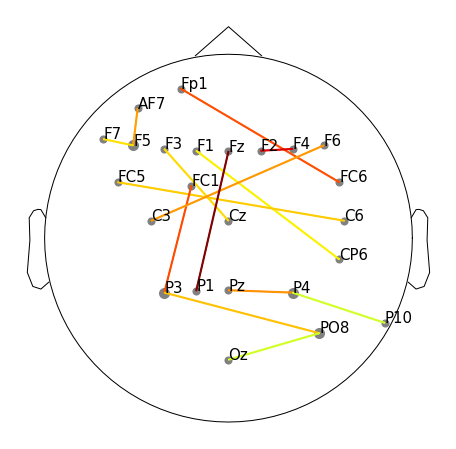

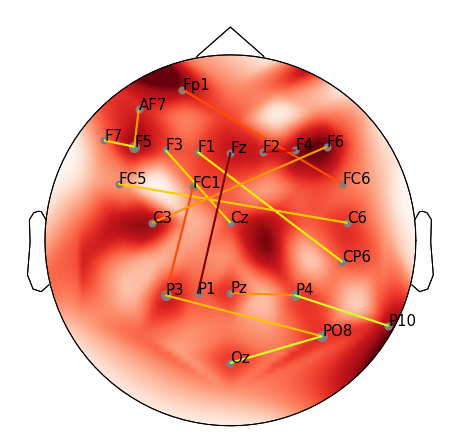

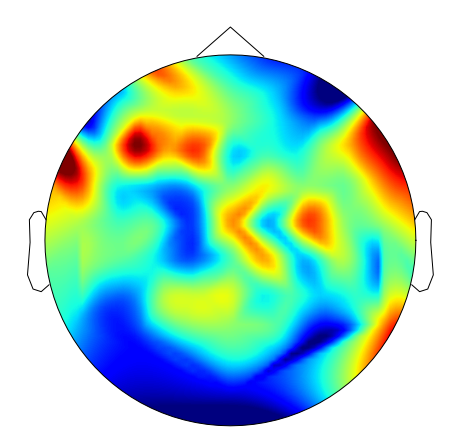

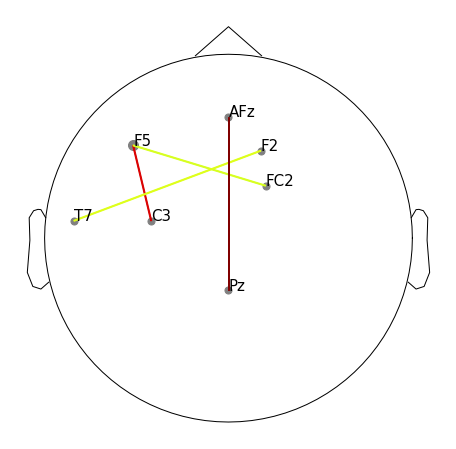

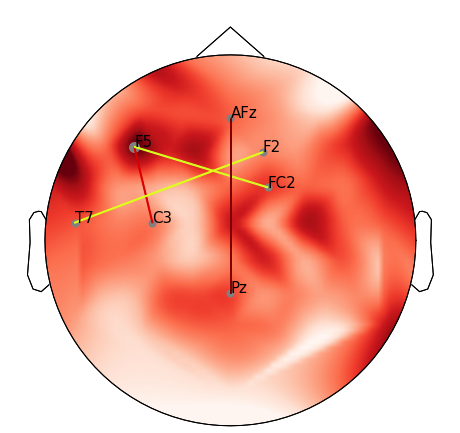

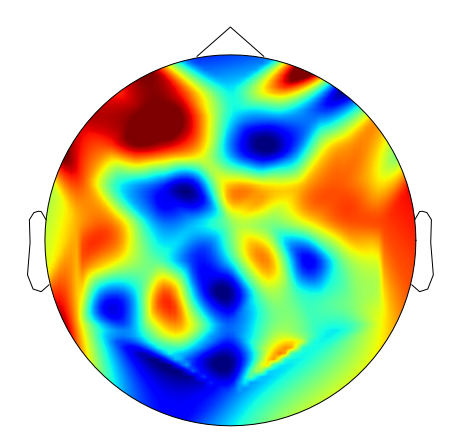

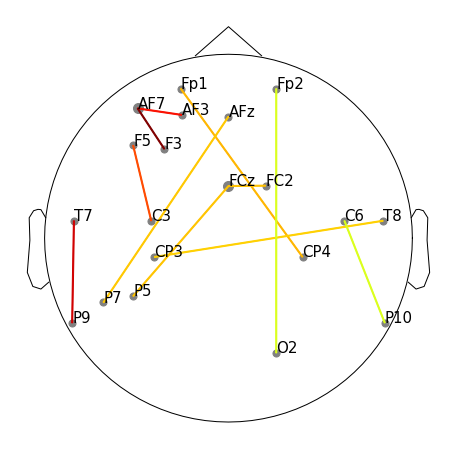

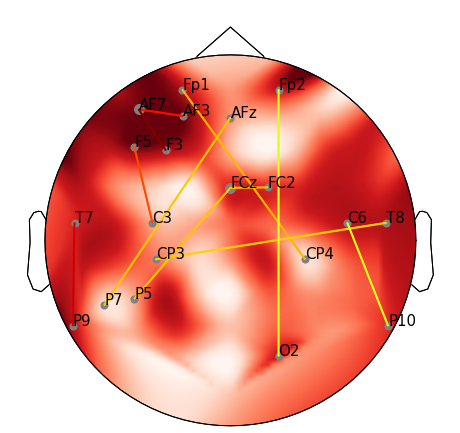

grupos:  [2, 1, 0]
run:  1
Epoch 1/200
2/2 [==============================] - 1s 215ms/step - loss: 720.1608 - val_loss: 684.8759
Epoch 2/200
2/2 [==============================] - 0s 57ms/step - loss: 699.7499 - val_loss: 646.3647
Epoch 3/200
2/2 [==============================] - 0s 57ms/step - loss: 654.6156 - val_loss: 606.0985
Epoch 4/200
2/2 [==============================] - 0s 54ms/step - loss: 606.1342 - val_loss: 555.2314
Epoch 5/200
2/2 [==============================] - 0s 55ms/step - loss: 556.5765 - val_loss: 516.4351
Epoch 6/200
2/2 [==============================] - 0s 54ms/step - loss: 518.6917 - val_loss: 480.2125
Epoch 7/200
2/2 [==============================] - 0s 55ms/step - loss: 479.1574 - val_loss: 447.7566
Epoch 8/200
2/2 [==============================] - 0s 54ms/step - loss: 445.6857 - val_loss: 418.0657
Epoch 9/200
2/2 [==============================] - 0s 181ms/step - loss: 415.0783 - val_loss: 385.5720
Epoch 10/200
2/2 [==============================] - 0

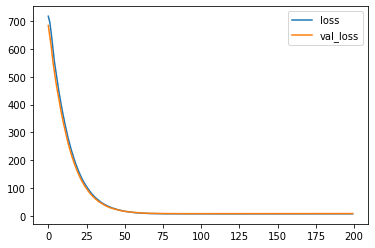

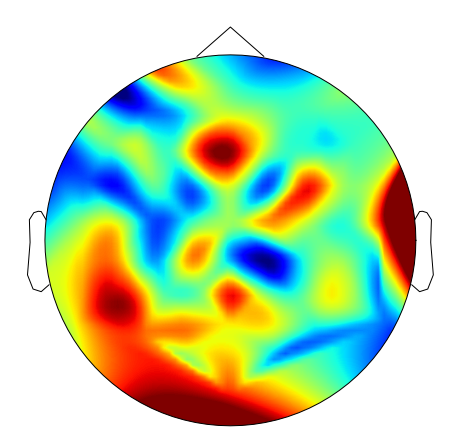

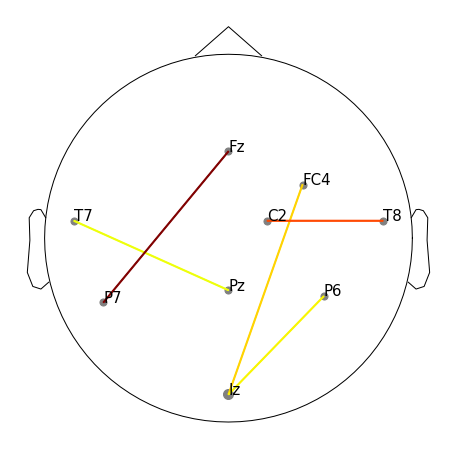

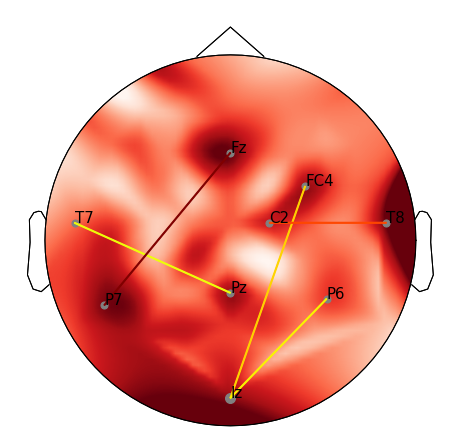

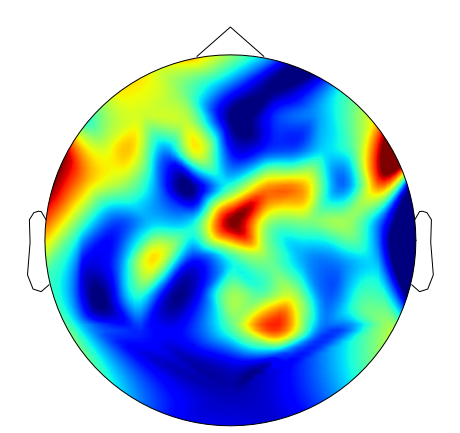

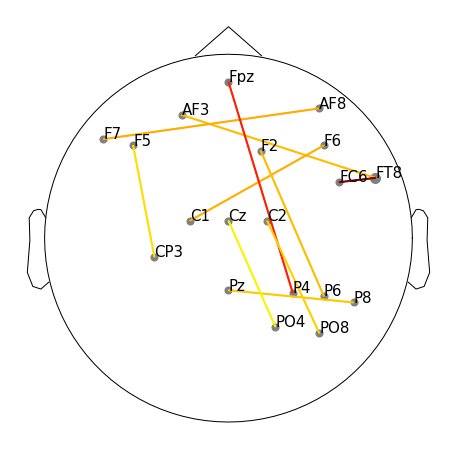

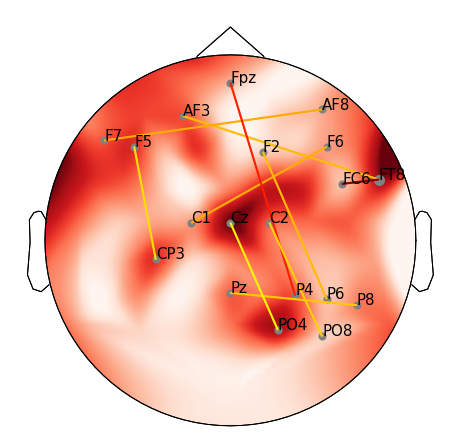

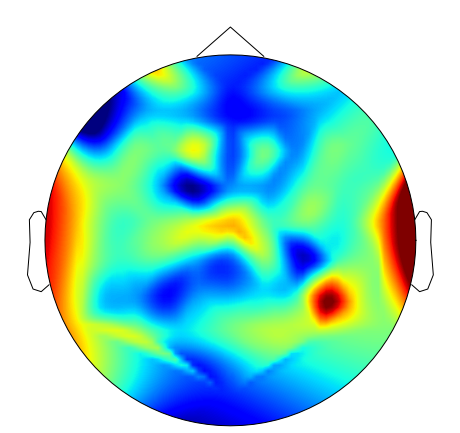

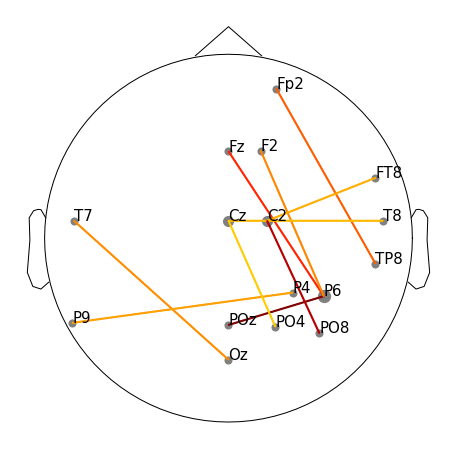

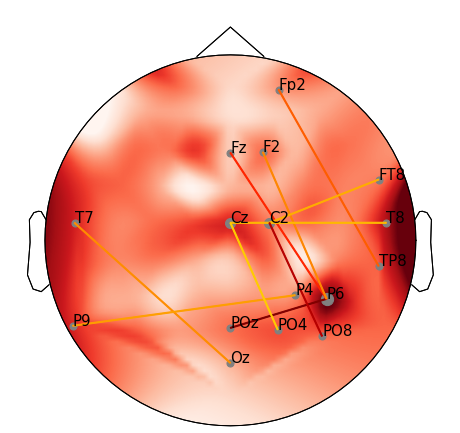

run:  2
Epoch 1/200
2/2 [==============================] - 1s 214ms/step - loss: 721.3255 - val_loss: 689.5149
Epoch 2/200
2/2 [==============================] - 0s 56ms/step - loss: 697.8711 - val_loss: 656.6256
Epoch 3/200
2/2 [==============================] - 0s 56ms/step - loss: 662.6714 - val_loss: 605.9198
Epoch 4/200
2/2 [==============================] - 0s 54ms/step - loss: 611.2029 - val_loss: 555.8237
Epoch 5/200
2/2 [==============================] - 0s 58ms/step - loss: 557.4684 - val_loss: 523.2389
Epoch 6/200
2/2 [==============================] - 0s 182ms/step - loss: 518.8188 - val_loss: 486.2237
Epoch 7/200
2/2 [==============================] - 0s 60ms/step - loss: 480.4101 - val_loss: 446.9053
Epoch 8/200
2/2 [==============================] - 0s 56ms/step - loss: 444.0253 - val_loss: 417.1193
Epoch 9/200
2/2 [==============================] - 0s 56ms/step - loss: 414.0180 - val_loss: 385.4065
Epoch 10/200
2/2 [==============================] - 0s 54ms/step - loss:

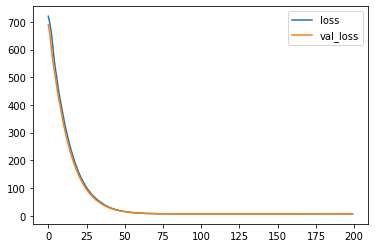

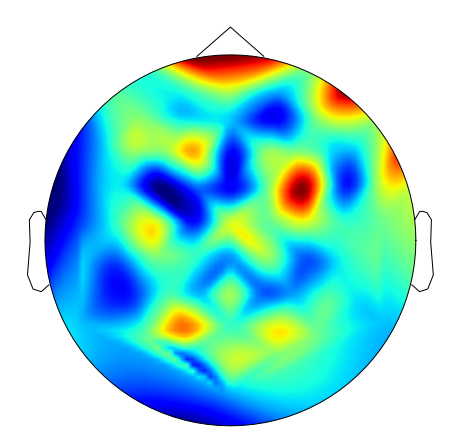

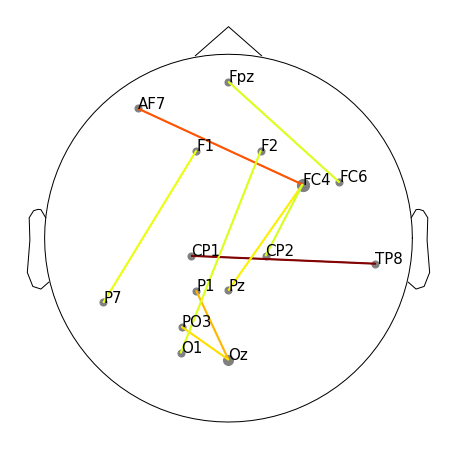

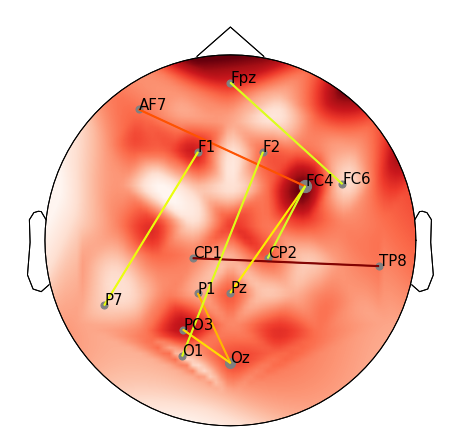

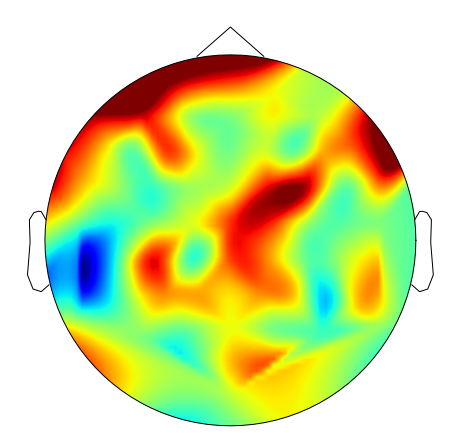

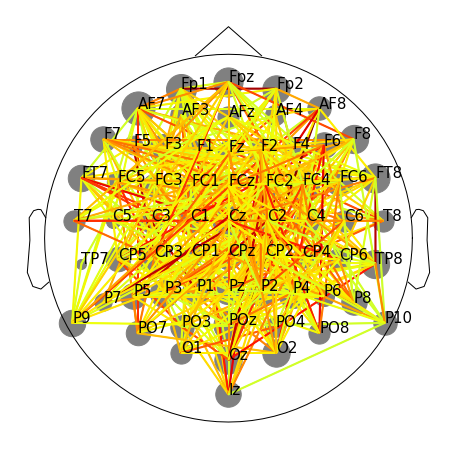

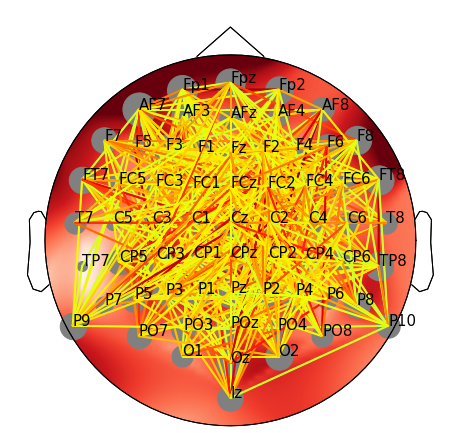

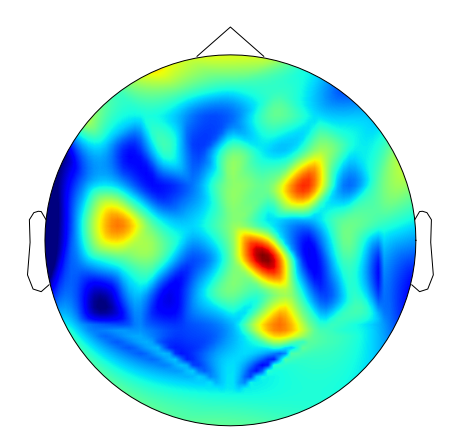

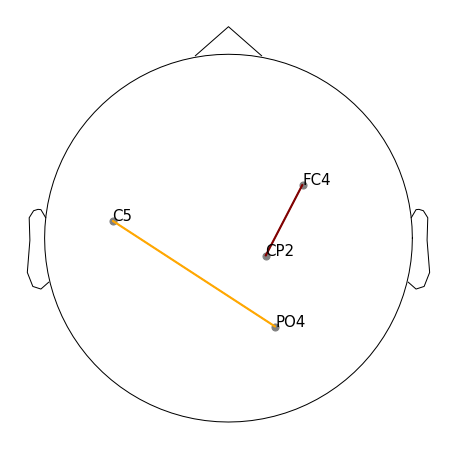

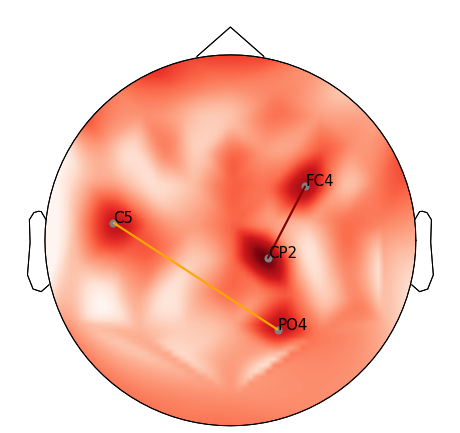

run:  3
Epoch 1/200
2/2 [==============================] - 1s 212ms/step - loss: 719.1458 - val_loss: 680.0546
Epoch 2/200
2/2 [==============================] - 0s 56ms/step - loss: 702.2116 - val_loss: 640.0098
Epoch 3/200
2/2 [==============================] - 0s 56ms/step - loss: 656.0718 - val_loss: 592.8789
Epoch 4/200
2/2 [==============================] - 0s 55ms/step - loss: 609.2863 - val_loss: 552.0963
Epoch 5/200
2/2 [==============================] - 0s 54ms/step - loss: 559.5440 - val_loss: 515.4302
Epoch 6/200
2/2 [==============================] - 0s 52ms/step - loss: 518.6538 - val_loss: 478.6651
Epoch 7/200
2/2 [==============================] - 0s 56ms/step - loss: 479.8954 - val_loss: 446.0894
Epoch 8/200
2/2 [==============================] - 0s 55ms/step - loss: 444.5019 - val_loss: 414.1558
Epoch 9/200
2/2 [==============================] - 0s 61ms/step - loss: 412.8306 - val_loss: 385.1653
Epoch 10/200
2/2 [==============================] - 0s 62ms/step - loss: 

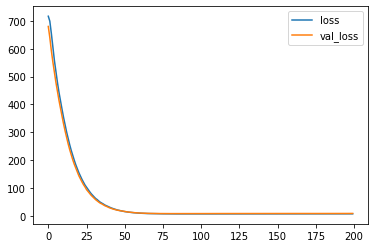

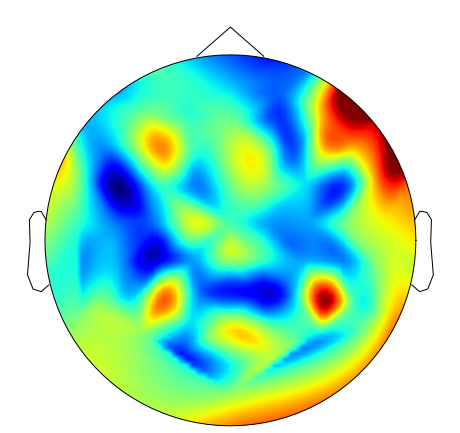

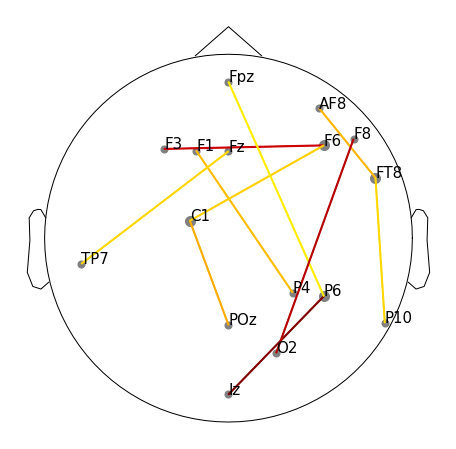

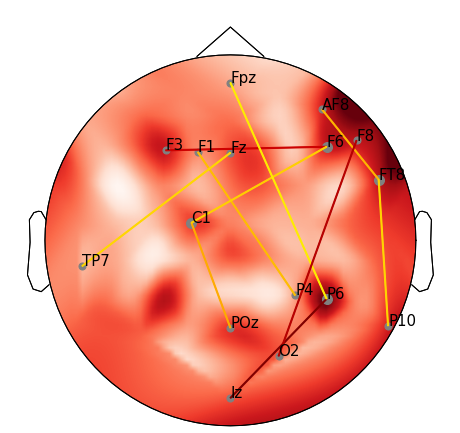

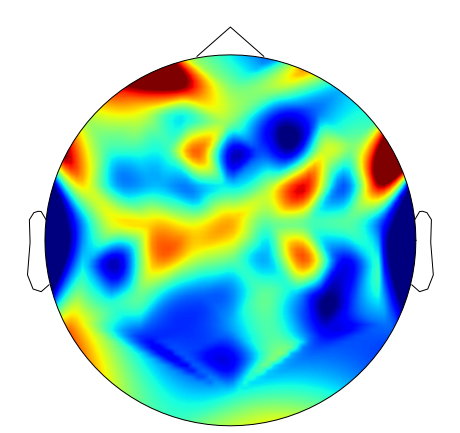

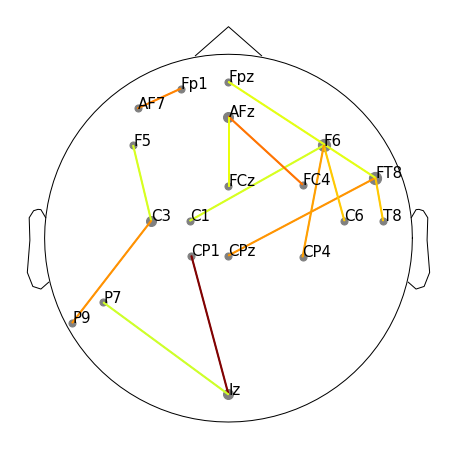

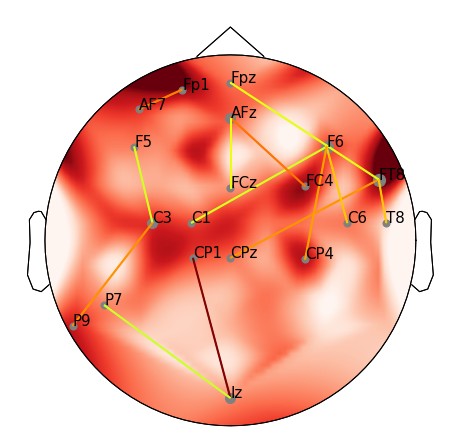

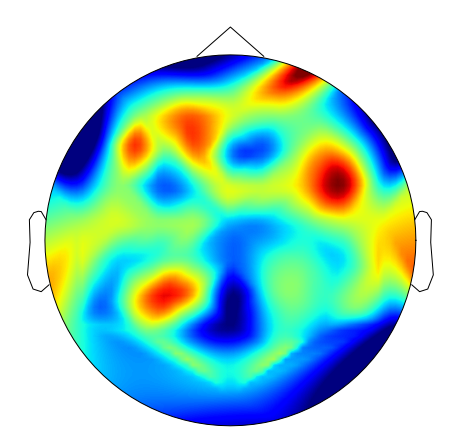

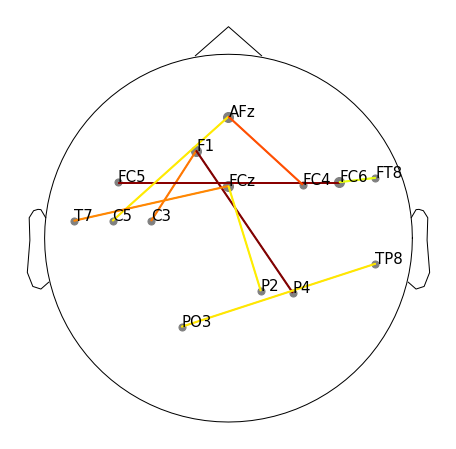

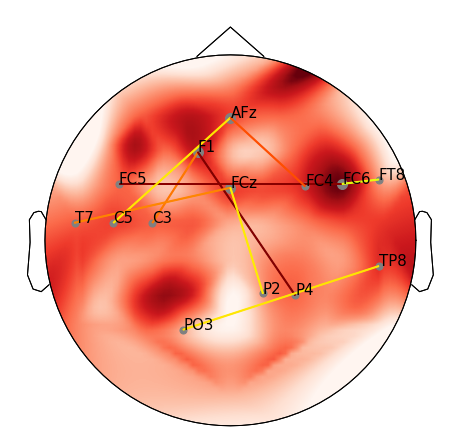

run:  4
Epoch 1/200
2/2 [==============================] - 1s 219ms/step - loss: 719.5120 - val_loss: 687.6411
Epoch 2/200
2/2 [==============================] - 0s 57ms/step - loss: 703.9268 - val_loss: 654.0381
Epoch 3/200
2/2 [==============================] - 0s 55ms/step - loss: 657.4072 - val_loss: 599.7237
Epoch 4/200
2/2 [==============================] - 0s 56ms/step - loss: 605.3263 - val_loss: 561.2498
Epoch 5/200
2/2 [==============================] - 0s 54ms/step - loss: 558.3988 - val_loss: 525.3762
Epoch 6/200
2/2 [==============================] - 0s 54ms/step - loss: 519.5444 - val_loss: 483.1111
Epoch 7/200
2/2 [==============================] - 0s 185ms/step - loss: 479.8969 - val_loss: 448.0753
Epoch 8/200
2/2 [==============================] - 0s 54ms/step - loss: 446.1221 - val_loss: 415.5582
Epoch 9/200
2/2 [==============================] - 0s 54ms/step - loss: 412.9190 - val_loss: 385.4371
Epoch 10/200
2/2 [==============================] - 0s 53ms/step - loss:

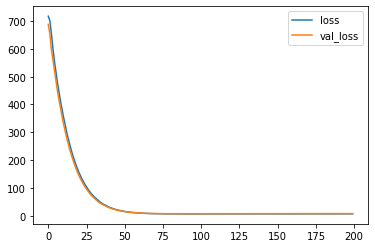

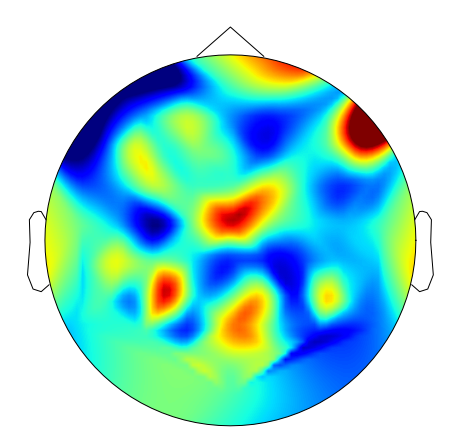

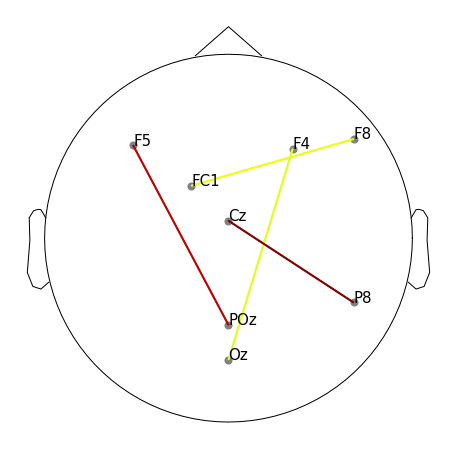

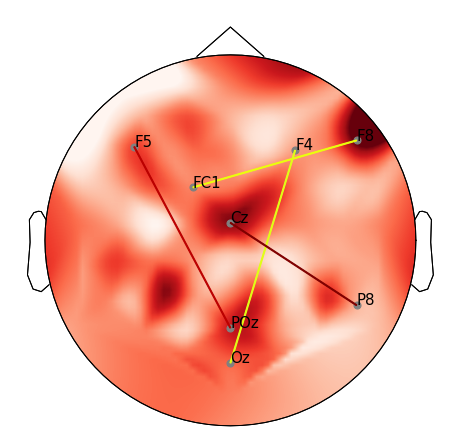

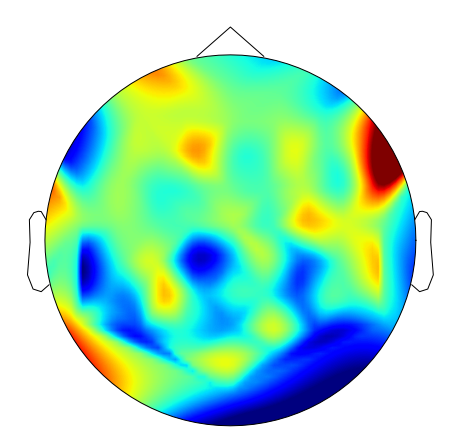

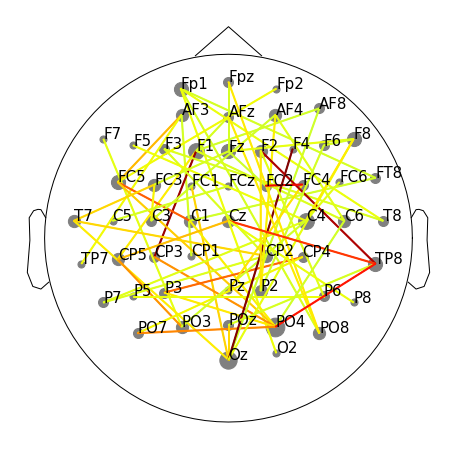

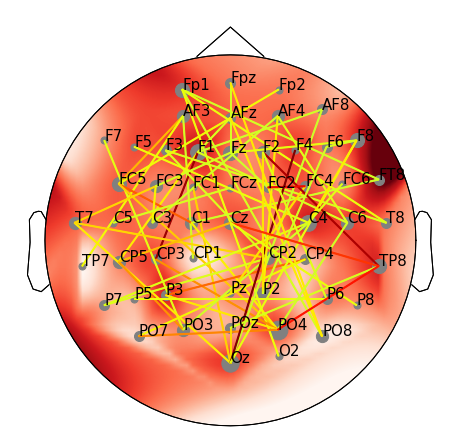

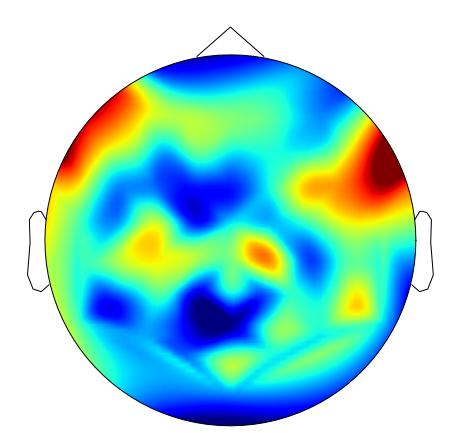

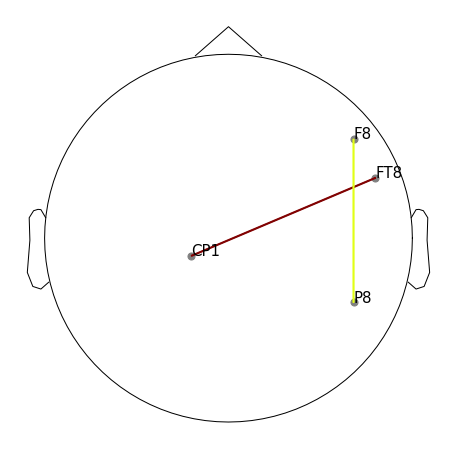

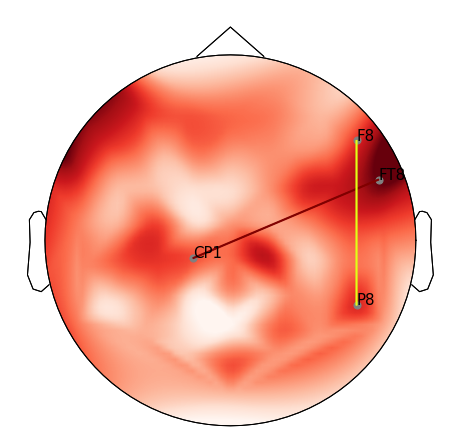

run:  5
Epoch 1/200
2/2 [==============================] - 1s 224ms/step - loss: 719.2506 - val_loss: 696.7277
Epoch 2/200
2/2 [==============================] - 0s 57ms/step - loss: 705.4047 - val_loss: 652.6873
Epoch 3/200
2/2 [==============================] - 0s 58ms/step - loss: 657.8061 - val_loss: 599.1655
Epoch 4/200
2/2 [==============================] - 0s 220ms/step - loss: 610.7833 - val_loss: 554.6295
Epoch 5/200
2/2 [==============================] - 0s 55ms/step - loss: 560.3028 - val_loss: 515.5474
Epoch 6/200
2/2 [==============================] - 0s 54ms/step - loss: 518.0868 - val_loss: 480.3825
Epoch 7/200
2/2 [==============================] - 0s 54ms/step - loss: 479.4198 - val_loss: 449.9020
Epoch 8/200
2/2 [==============================] - 0s 54ms/step - loss: 445.2469 - val_loss: 417.8272
Epoch 9/200
2/2 [==============================] - 0s 55ms/step - loss: 413.7255 - val_loss: 385.5070
Epoch 10/200
2/2 [==============================] - 0s 60ms/step - loss:

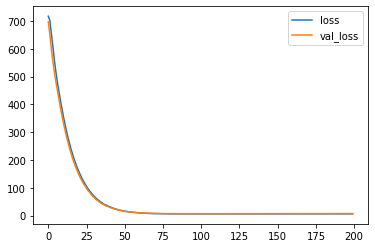

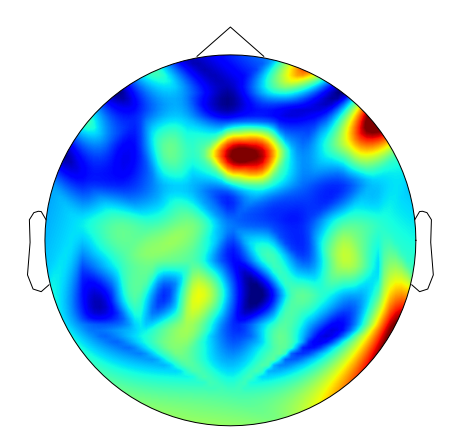

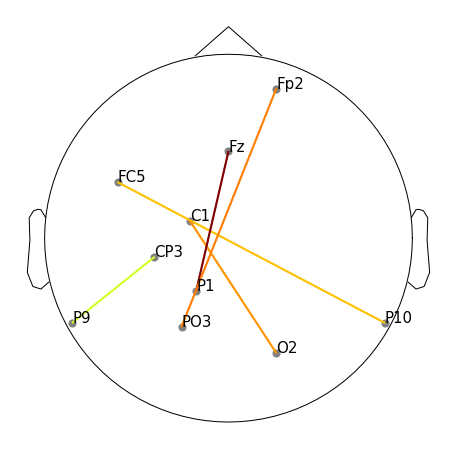

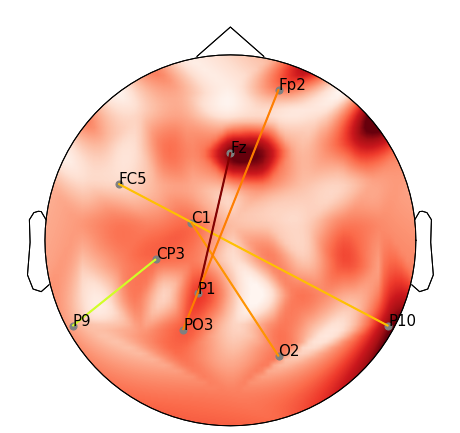

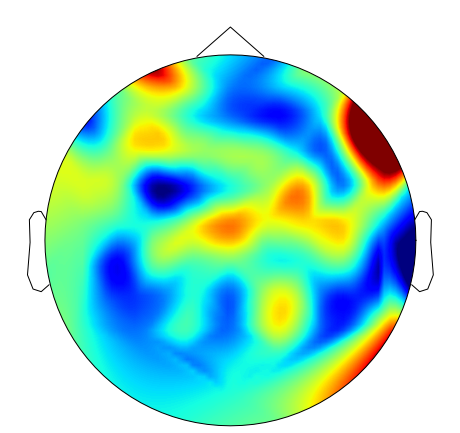

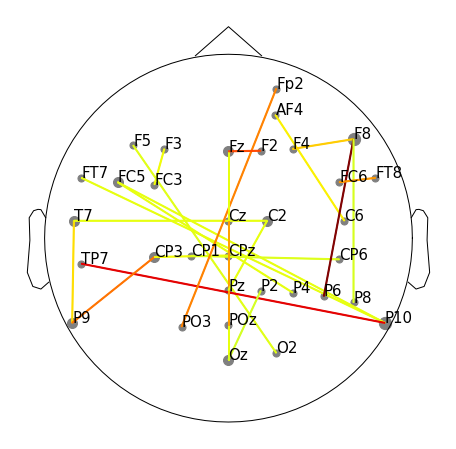

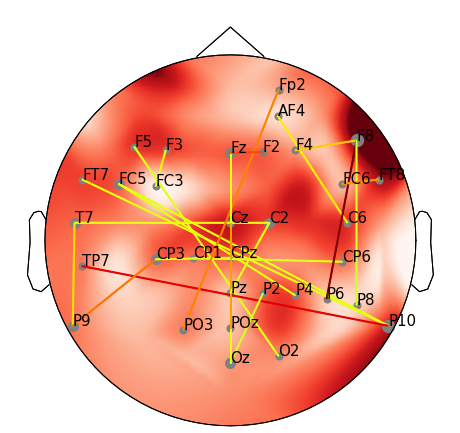

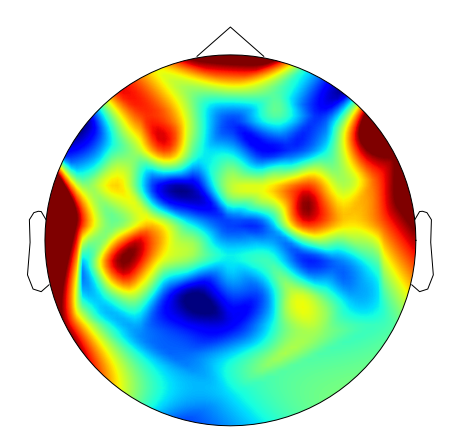

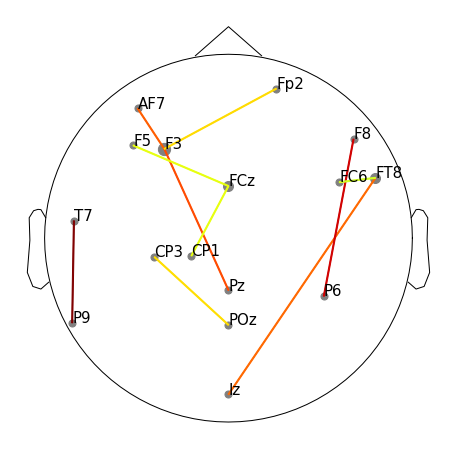

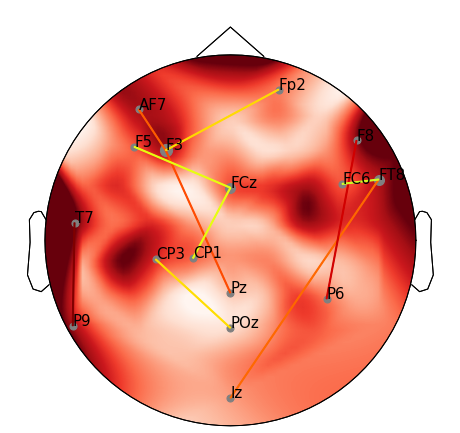

In [12]:
name_folder = 'R0_runs_vs_y_runs'

tipos =np.asarray([2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 1, 1 , 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1])#[1 2 3]
clases =[[2,None, None], [0,None, None],[1,None, None],[2,1, 0]]

db = loaddb.GIGA()
channels_names = db.metadata['channel_names']
montage = mne.channels.read_montage(db.metadata['montage'])

groups_names = ['1','2','3','All']

c = 0
for tipe in clases:
  print('grupos:  '+ str(tipe) )
  #seleccion de index por clase de sujetos
  idx= (tipos==tipe[0]) + (tipos==tipe[1]) + (tipos==tipe[2])
  #X = xtensor[idx,:,:]
  for r in range(5):
    print('run:  '+ str(r+1) )
    sc_ma = StandardScaler()
    y = sc_ma.fit_transform(Target_run[r][idx].reshape(-1,1))

    xtensor = get_run(plv_conect,r+1)
    X = xtensor[idx,:,:]

    feats= SMRfeat()
    X_feat = feats.fit_transform(X)
    net= MCSMRDNN(verbose=1,epochs=200,l1_param=1e-3,l2_param=1e-3,validation_split=0.1,plot_hst=True,alpha_dropout=False)
    predict_data = net.fit(X_feat , y)

    mdl = net.get_model()
    w = get_weigths(mdl,3)

    Model = {}
    Model["weigths"] = w
    Model["Ch_names"] = channels_names
    Model["montage"] = montage

    with open(Path_def+'models/'+name_folder+'/PLV_3f_MC_'+groups_names[c]+'_r'+str(r+1)+'.p','wb') as handle:
                    pickle.dump(Model,handle)

    plot_topomap_cx(w[0],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="topo",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_topo_t')
    plot_topomap_cx(w[0],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="Cx",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_Cx_t')
    plot_topomap_cx(w[0],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="All",cmaps="Reds",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_All_t')

    plot_topomap_cx(w[1],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="topo",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_topo_u')
    plot_topomap_cx(w[1],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="Cx",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_Cx_u')
    plot_topomap_cx(w[1],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="All",cmaps="Reds",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_All_u')

    plot_topomap_cx(w[2],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="topo",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_topo_B')
    plot_topomap_cx(w[2],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="Cx",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_Cx_B')
    plot_topomap_cx(w[2],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="All",cmaps="Reds",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_All_B')
  c+=1